<p style="align: center;"><img align=center src="https://drive.google.com/uc?export=view&id=1I8kDikouqpH4hf7JBiSYAeNT2IO52T-T" width=600 height=480/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Весна 2021</b></h3>

# Autoencoders


# Часть 1. Vanilla Autoencoder (10 баллов)

## 1.1. Подготовка данных (0.5 балла)


In [1]:
# !pip install wget

In [2]:
import os
import pandas as pd
import numpy as np
from skimage.transform import resize
from sklearn.model_selection import train_test_split
from tqdm.notebook import tqdm
import skimage.io
import wget
from torch.autograd import Variable
from sklearn.preprocessing import LabelBinarizer
from torchvision import datasets, transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as data_utils
import torch
import os
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
# wget.download('http://vis-www.cs.umass.edu/lfw/lfw-deepfunneled.tgz')
# wget.download('http://www.cs.columbia.edu/CAVE/databases/pubfig/download/lfw_attributes.txt')

In [4]:
def fetch_dataset(attrs_name = "lfw_attributes.txt",
                      images_name = "lfw-deepfunneled",
                      dx=80,dy=80,
                      dimx=64,dimy=64
    ):

#     #download if not exists
#     if not os.path.exists(images_name):
#         print("images not found, donwloading...")
#         os.system("wget http://vis-www.cs.umass.edu/lfw/lfw-deepfunneled.tgz -O tmp.tgz")
#         print("extracting...")
#         os.system("tar xvzf tmp.tgz && rm tmp.tgz")
#         print("done")
#         assert os.path.exists(images_name)

#     if not os.path.exists(attrs_name):
#         print("attributes not found, downloading...")
#         os.system("wget http://www.cs.columbia.edu/CAVE/databases/pubfig/download/%s" % attrs_name)
#         print("done")

    #read attrs
    df_attrs = pd.read_csv("lfw_attributes.txt",sep='\t',skiprows=1,) 
    df_attrs = pd.DataFrame(df_attrs.iloc[:,:-1].values, columns = df_attrs.columns[1:])


    #read photos
    photo_ids = []
    for dirpath, dirnames, filenames in os.walk(images_name):
        for fname in filenames:
            if fname.endswith(".jpg"):
                fpath = os.path.join(dirpath,fname)
                photo_id = fname[:-4].replace('_',' ').split()
                person_id = ' '.join(photo_id[:-1])
                photo_number = int(photo_id[-1])
                photo_ids.append({'person':person_id,'imagenum':photo_number,'photo_path':fpath})

    photo_ids = pd.DataFrame(photo_ids)
    # print(photo_ids)
    #mass-merge
    #(photos now have same order as attributes)
    df = pd.merge(df_attrs,photo_ids,on=('person','imagenum'))

    assert len(df)==len(df_attrs),"lost some data when merging dataframes"

    # print(df.shape)
    #image preprocessing
    all_photos =df['photo_path'].apply(skimage.io.imread)\
                                .apply(lambda img:img[dy:-dy,dx:-dx])\
                                .apply(lambda img: resize(img,[dimx,dimy]))

    all_photos = np.stack(all_photos.values)#.astype('uint8')
    all_attrs = df.drop(["photo_path","person","imagenum"],axis=1)
    
    return all_photos, all_attrs

In [5]:
# The following line fetches you two datasets: images, usable for autoencoder training and attributes.
# Those attributes will be required for the final part of the assignment (applying smiles), so please keep them in mind
# from get_dataset import fetch_dataset
data, attrs = fetch_dataset()

In [6]:
print(f'Shape of dataset {data.shape} with num of pics: {data.shape[0]}')
print(f'Shape of dataset {attrs.shape}')

Shape of dataset (13143, 64, 64, 3) with num of pics: 13143
Shape of dataset (13143, 73)



Разбейте выборку картинок на train и val, выведите несколько картинок в output, чтобы посмотреть, как они выглядят, и приведите картинки к тензорам pytorch, чтобы можно было скормить их сети:

In [7]:
BATCH_SIZE = 128

In [8]:
train_photos, val_photos, train_attrs, val_attrs = train_test_split(data, attrs, test_size=.2, shuffle=False)

In [9]:
train_loader = torch.utils.data.DataLoader(
    train_photos, batch_size=BATCH_SIZE, pin_memory=True, num_workers=4)
val_loader = torch.utils.data.DataLoader(
    val_photos, batch_size=BATCH_SIZE, pin_memory=True, num_workers=4)

In [10]:
print(f'Shape of train dataset: {train_photos.shape}')
print(f'Shape of val dataset: {val_photos.shape}')

Shape of train dataset: (10514, 64, 64, 3)
Shape of val dataset: (2629, 64, 64, 3)


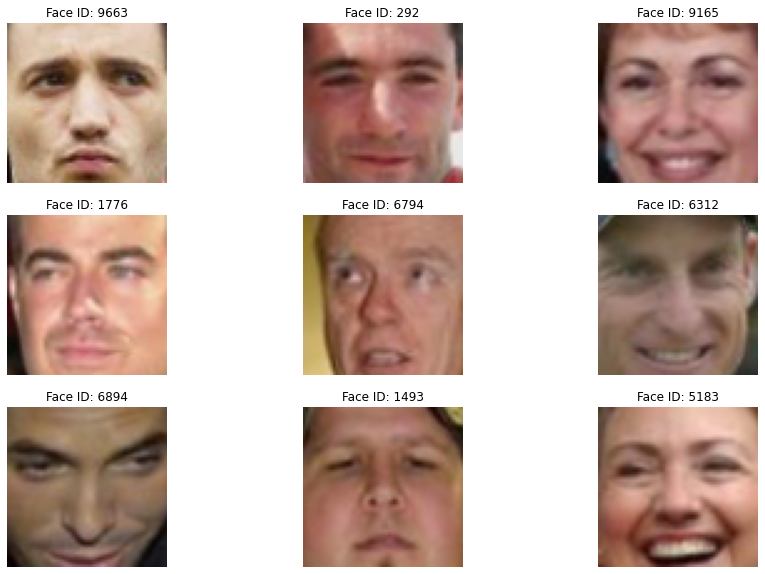

In [11]:
plt.figure(figsize=(15, 10))
for i in range(9):
    idx = int(np.random.uniform(0, len(train_photos)))
    img = train_photos[idx]
    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.title(f'Face ID: {idx}')
    plt.axis('off')
plt.show()

## 1.2. Архитектура модели (1.5 балла)
В этом разделе мы напишем и обучем обычный автоэнкодер.



<img src="https://www.notion.so/image/https%3A%2F%2Fs3-us-west-2.amazonaws.com%2Fsecure.notion-static.com%2F4b8adf79-8e6a-4b7d-9061-8617a00edbb1%2F__2021-04-30__14.53.33.png?table=block&id=56f187b4-279f-4208-b1ed-4bda5f91bfc0&width=2880&userId=3b1b5e32-1cfb-4b0f-8705-5a524a8f56e3&cache=v2" alt="Autoencoder">


^ напомню, что автоэнкодер выглядит вот так

Реализуем autoencoder. Архитектуру (conv, fully-connected, ReLu, etc) можете выбирать сами. Экспериментируйте!

In [13]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [14]:
a = iter(train_loader).next().to(device)

In [15]:
print(f'MAX value {torch.max(a[0])}  MIN value {torch.min(a[0])}')

MAX value 0.9275055530024511  MIN value 0.0


#### Занчения от 0 до 1, используем Sigmoid

In [16]:
from copy import deepcopy

class Autoencoder(nn.Module):
    def __init__(self):
        super().__init__()        
#         encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 3, stride=2, padding=1),  # N 64, 32, 32  (64-3+2)/2
            nn.ReLU(),
            nn.Conv2d(64, 128, 3, stride=2, padding=1),  # N 128, 16, 16  (32-3+2)/2
            nn.ReLU(),
            nn.Conv2d(128, 256, 3, stride=2, padding=1),  # N 256, 8, 8  (16-3+2)/2
            nn.ReLU(),
            nn.Conv2d(256, 512, 3, stride=2, padding=1),  # N 512, 4, 4  (8-3+2)/2
            nn.ReLU(),
            nn.Conv2d(512, 1024, 4),  # N 1024, 1, 1  (4-4+0)/1
        )
        
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(1024, 512, 4), # N 512, 4, 4
            nn.ReLU(),
            nn.ConvTranspose2d(512, 256, 3, stride=2, padding=1, output_padding=1),  # N 256, 8, 8
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 3, stride=2, padding=1, output_padding=1), # N 128, 16, 16
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 3, stride=2, padding=1, output_padding=1), # N 64, 32, 32
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 3, stride=2, padding=1, output_padding=1), # N 3, 64, 64
            nn.Sigmoid(),
            
        )
        
        
    def forward(self, x):
        latent_vector = self.encoder(x)
        reconstruction = self.decoder(latent_vector)
    

        
        return reconstruction, latent_vector
    
    def sample(self,z):
        output = self.decoder(z)
        output = output.view(-1, 64, 64, 3)
        return output

In [17]:
criterion = nn.MSELoss()
autoencoder = Autoencoder().to(device)
lr = 1e-3
optimizer = torch.optim.Adam(autoencoder.parameters(), lr=lr, weight_decay=1e-5)

In [18]:
def train(model, dataloader, criterion, optim):
    model.train()
    
    train_loss = 0
    
    for img in tqdm(dataloader):
        img = img.to(device)
        img = img.view(-1, 3, 64, 64).float()
        recon, _ = model(img)
#         loss = criterion(img, recon)
        loss = ((img - recon)**2).sum()
        optim.zero_grad()
        loss.backward()
        optim.step()
        train_loss += loss.item()
    avg_loss = train_loss/len(dataloader.dataset)
        
        
       
    return avg_loss

def test(model, dataloader, criterion):
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for img in tqdm(dataloader):
            img = img.to(device)
            img = img.view(-1, 3, 64, 64).float()
            enc, _ = model(img)
#             loss = criterion(img, enc)           
            loss = ((img - enc)**2).sum()
            val_loss += loss.item()
        avg_loss = val_loss/len(dataloader.dataset)
    return avg_loss

## 1.3 Обучение (2 балла)

Осталось написать код обучения автоэнкодера. При этом было бы неплохо в процессе иногда смотреть, как автоэнкодер реконструирует изображения на данном этапе обучения. Наример, после каждой эпохи (прогона train выборки через автоэекодер) можно смотреть, какие реконструкции получились для каких-то изображений val выборки.

А, ну еще было бы неплохо выводить графики train и val лоссов в процессе тренировки =)

In [19]:
def plot_ae_outputs(encoder,decoder,test_set,n=5):
    plt.figure(figsize=(10,4.5))
    for i in range(n):
        ax = plt.subplot(2,n,i+1)
        img = test_set[i]#[0].unsqueeze(0).to(device)
        img = torch.Tensor(img).unsqueeze(0).to(device)
        encoder.eval()
        decoder.eval()
        with torch.no_grad():
            
            rec_img  = decoder(encoder(img.view(-1,3,64,64).float()))
        plt.imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)  
        if i == n//2:
            ax.set_title('Original images')
        ax = plt.subplot(2, n, i + 1 + n)
        rec_img = rec_img.view(-1,64,64,3)
        plt.imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')  
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)  
        if i == n//2:
            ax.set_title('Reconstructed images')
    plt.show()

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 1/50 	 train loss 442.765 	 val loss 355.063


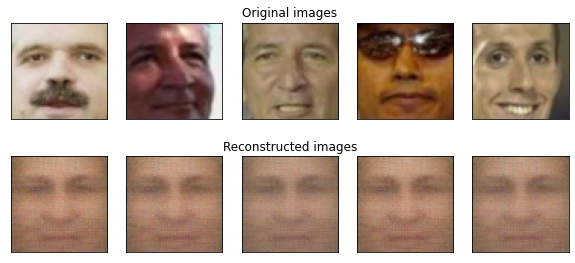

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 2/50 	 train loss 298.689 	 val loss 247.560


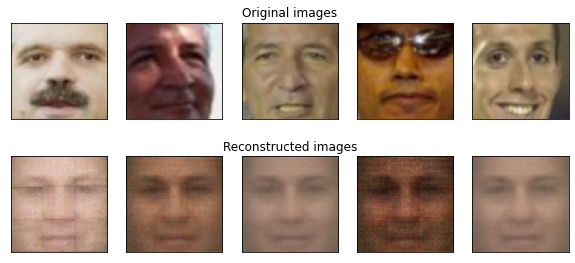

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 3/50 	 train loss 232.033 	 val loss 219.389


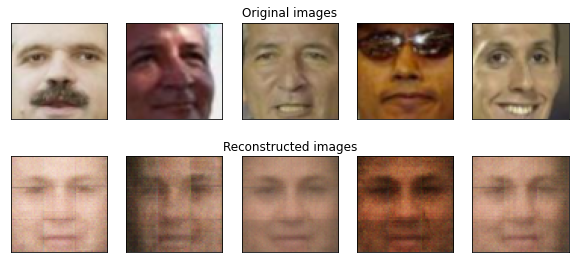

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 4/50 	 train loss 181.901 	 val loss 158.858


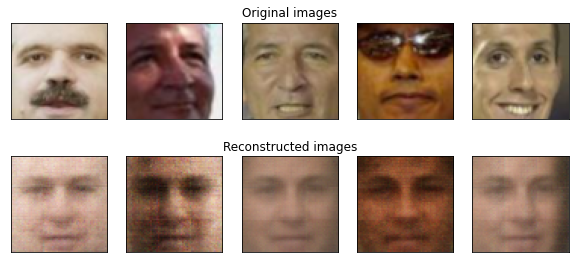

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 5/50 	 train loss 148.572 	 val loss 142.216


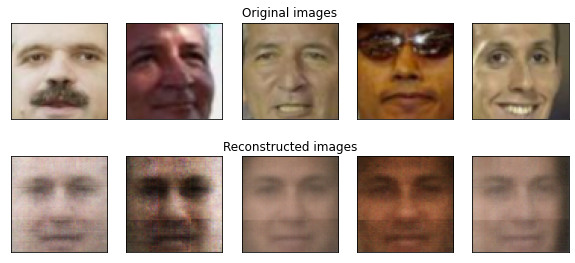

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 6/50 	 train loss 131.345 	 val loss 126.249


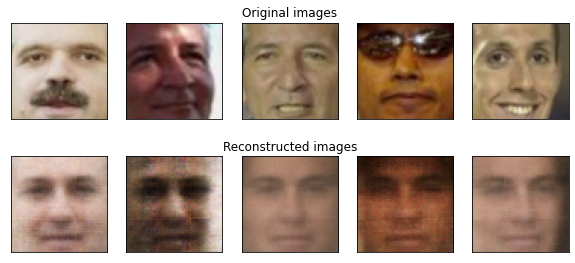

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 7/50 	 train loss 117.226 	 val loss 110.376


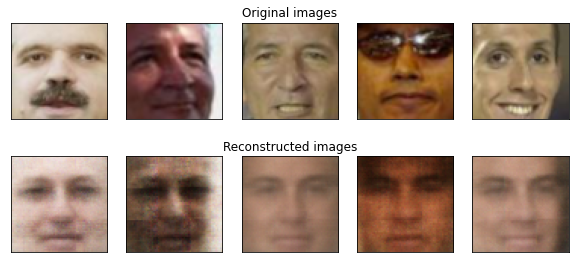

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 8/50 	 train loss 106.227 	 val loss 103.694


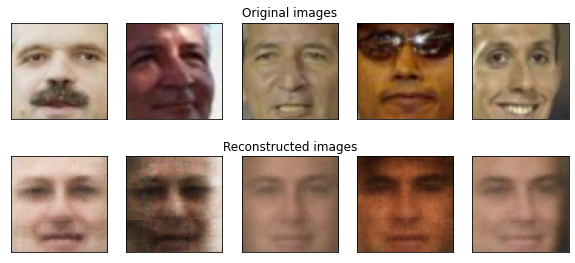

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 9/50 	 train loss 99.054 	 val loss 95.724


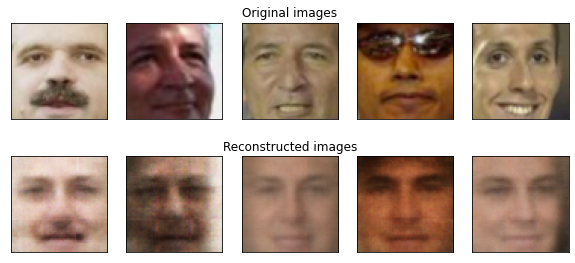

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 10/50 	 train loss 90.232 	 val loss 87.984


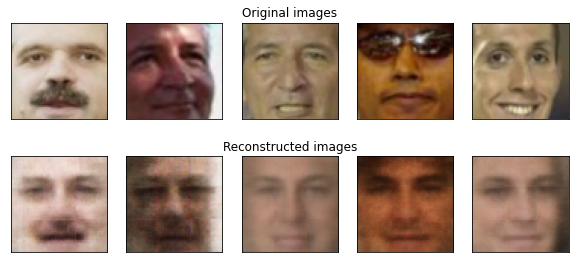

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 11/50 	 train loss 83.445 	 val loss 82.786


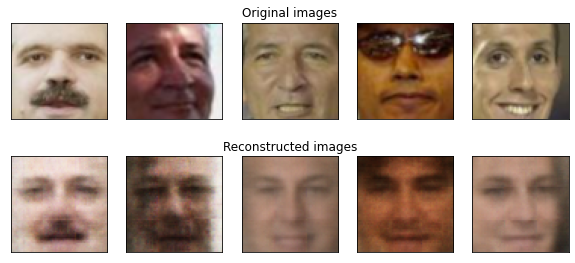

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 12/50 	 train loss 79.105 	 val loss 84.200


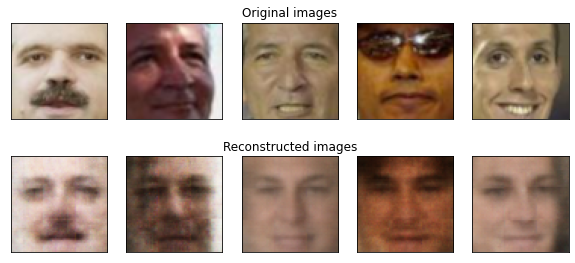

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 13/50 	 train loss 75.066 	 val loss 77.160


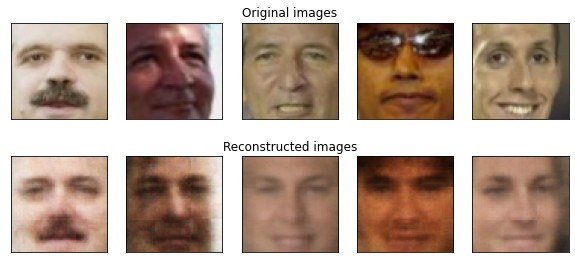

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 14/50 	 train loss 69.874 	 val loss 74.300


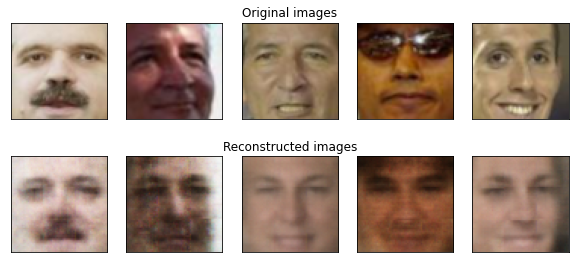

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 15/50 	 train loss 67.396 	 val loss 67.606


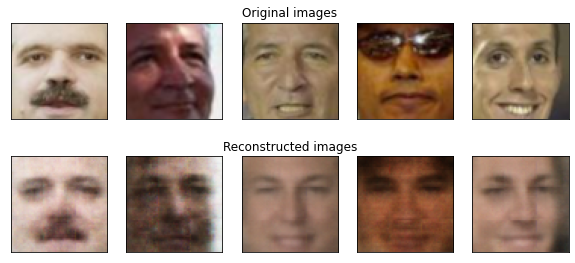

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 16/50 	 train loss 62.592 	 val loss 67.869


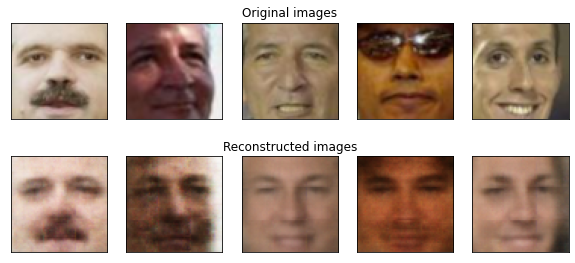

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 17/50 	 train loss 58.922 	 val loss 63.896


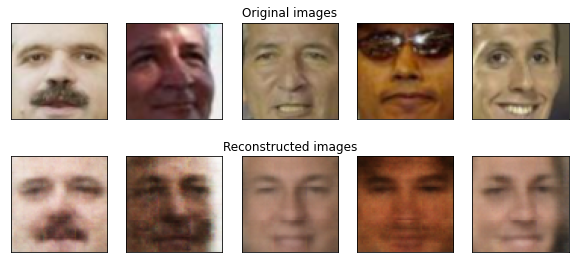

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 18/50 	 train loss 55.912 	 val loss 59.279


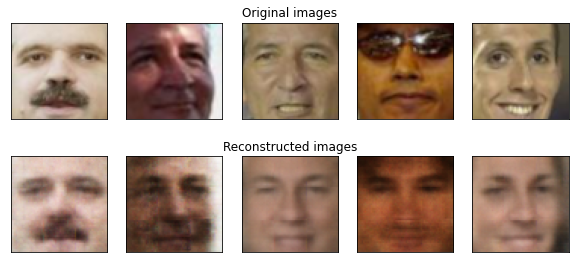

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 19/50 	 train loss 55.687 	 val loss 71.761


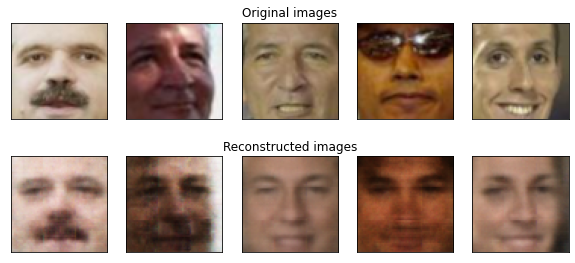

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 20/50 	 train loss 54.852 	 val loss 60.162


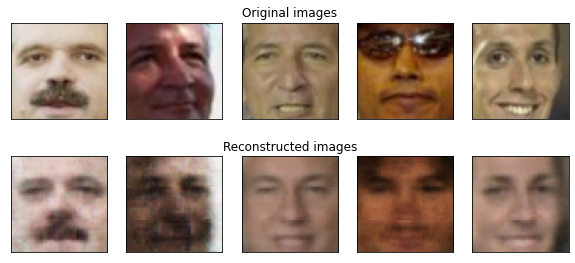

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 21/50 	 train loss 51.018 	 val loss 59.209


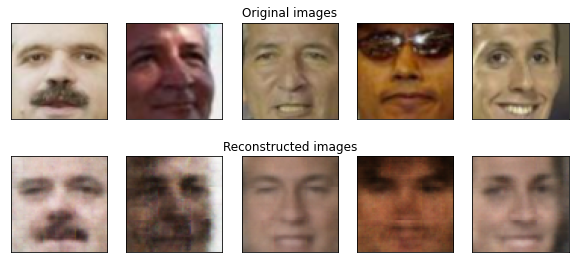

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 22/50 	 train loss 49.540 	 val loss 59.004


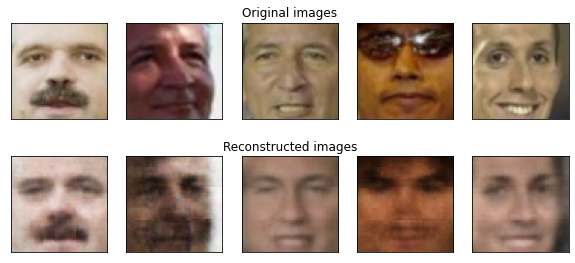

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 23/50 	 train loss 48.083 	 val loss 52.290


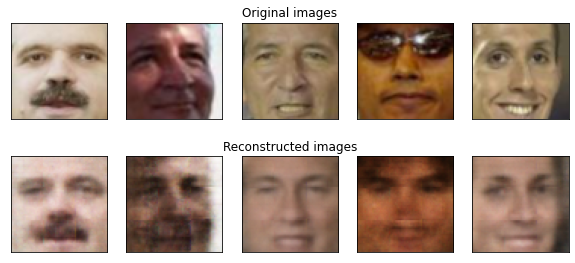

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 24/50 	 train loss 45.934 	 val loss 69.299


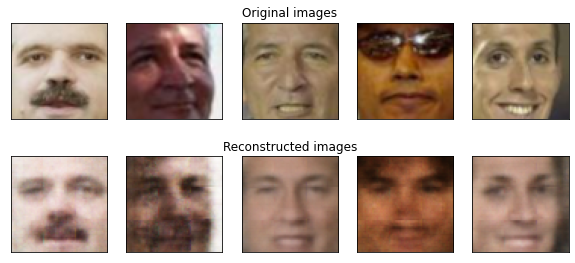

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 25/50 	 train loss 51.193 	 val loss 52.449


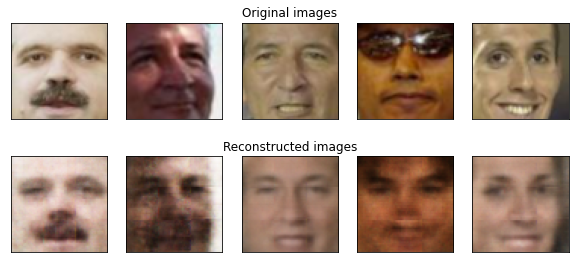

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 26/50 	 train loss 44.981 	 val loss 50.902


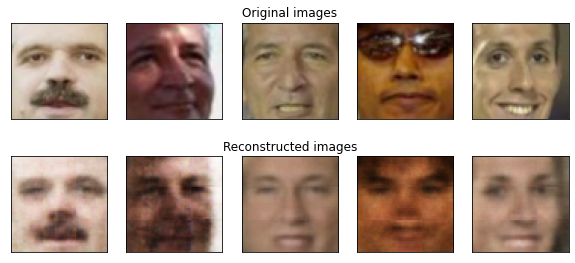

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 27/50 	 train loss 41.942 	 val loss 49.707


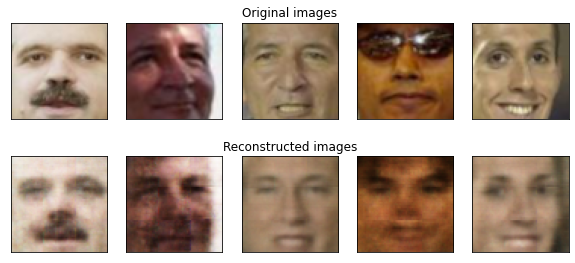

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 28/50 	 train loss 40.062 	 val loss 48.063


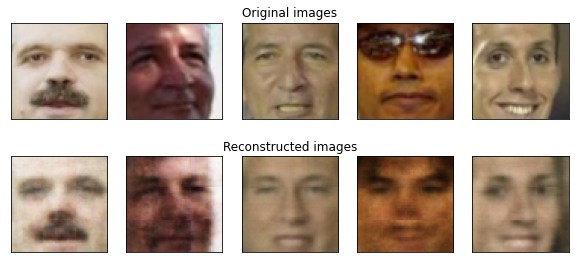

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 29/50 	 train loss 38.773 	 val loss 46.837


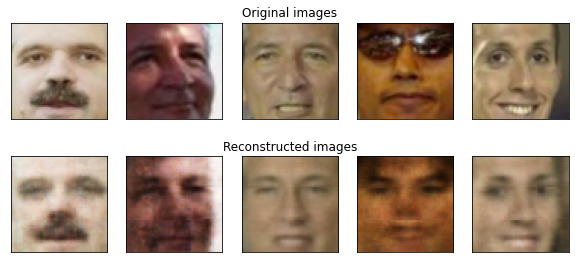

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 30/50 	 train loss 37.994 	 val loss 46.336


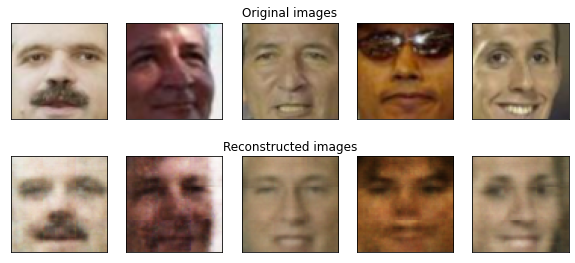

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 31/50 	 train loss 38.245 	 val loss 47.582


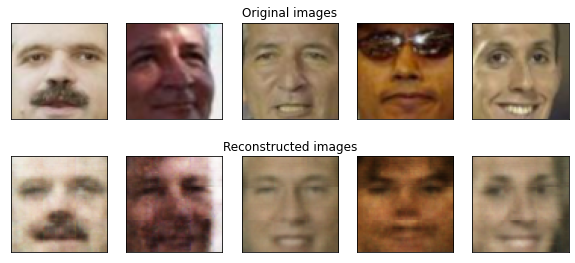

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 32/50 	 train loss 39.616 	 val loss 51.718


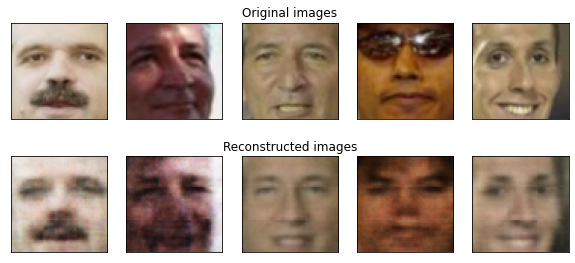

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 33/50 	 train loss 43.074 	 val loss 48.026


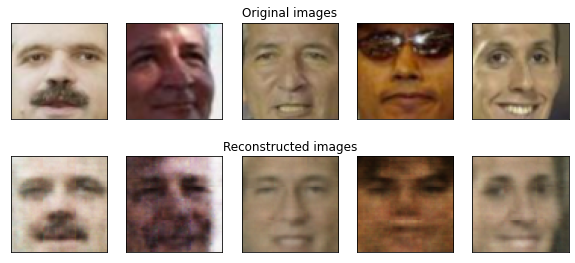

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 34/50 	 train loss 41.593 	 val loss 47.948


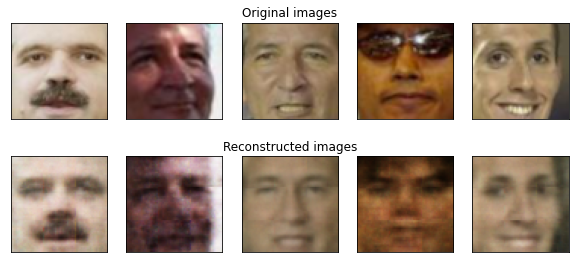

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 35/50 	 train loss 38.156 	 val loss 43.763


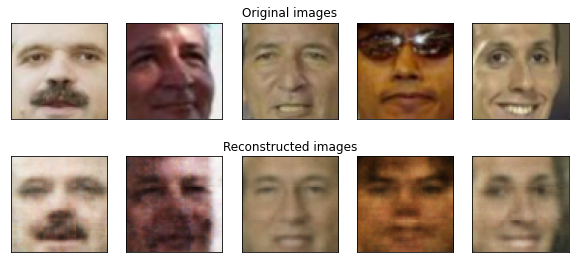

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 36/50 	 train loss 36.019 	 val loss 41.772


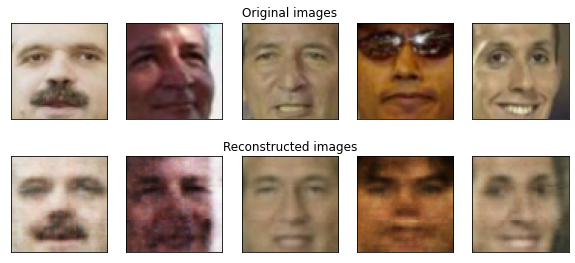

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 37/50 	 train loss 35.304 	 val loss 41.976


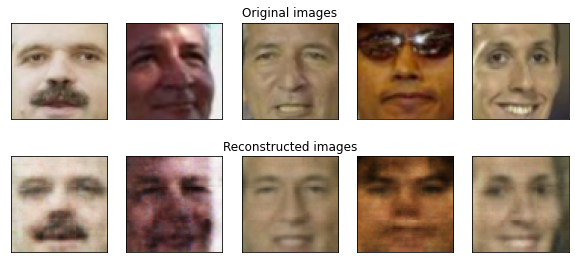

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 38/50 	 train loss 33.860 	 val loss 41.974


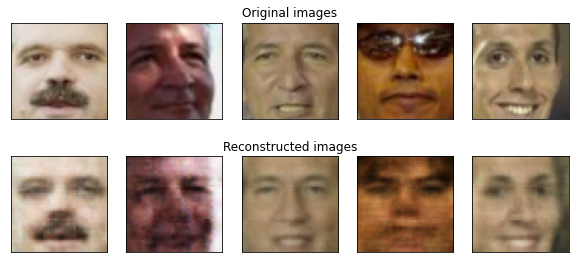

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 39/50 	 train loss 33.081 	 val loss 42.908


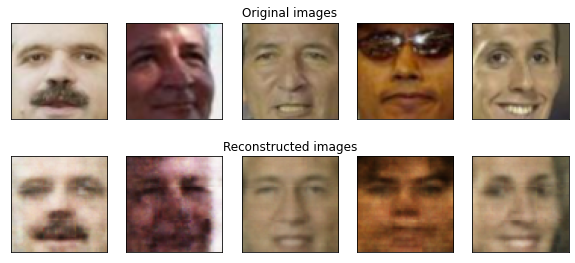

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 40/50 	 train loss 32.622 	 val loss 45.116


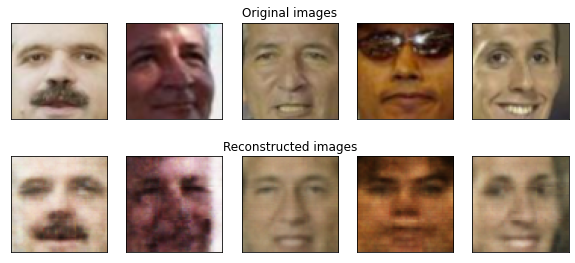

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 41/50 	 train loss 32.499 	 val loss 44.869


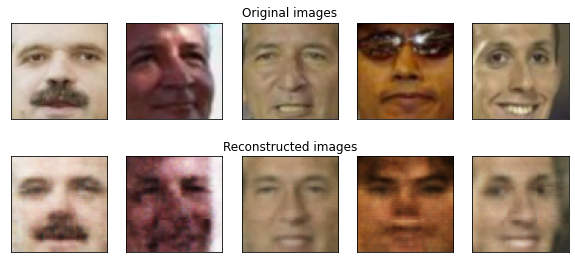

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 42/50 	 train loss 32.892 	 val loss 47.555


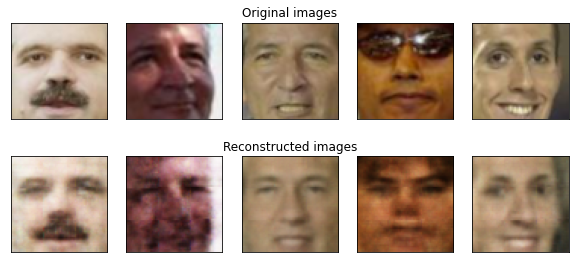

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 43/50 	 train loss 37.692 	 val loss 53.772


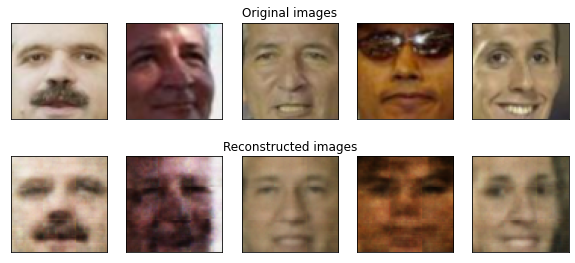

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 44/50 	 train loss 39.230 	 val loss 44.487


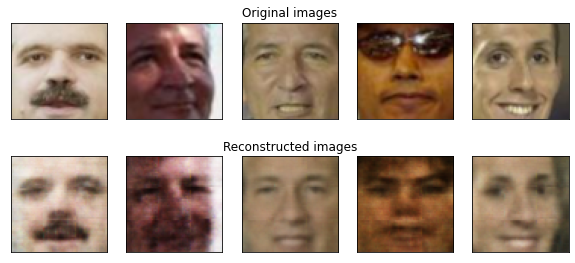

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 45/50 	 train loss 34.507 	 val loss 41.266


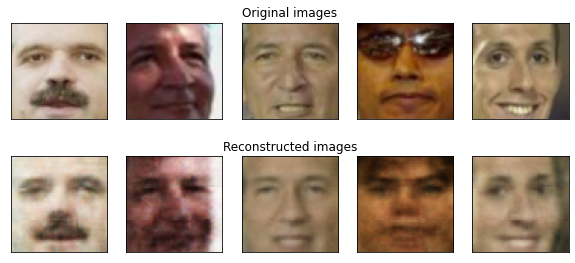

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 46/50 	 train loss 33.369 	 val loss 55.969


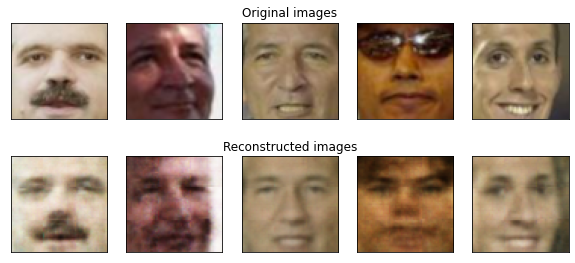

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 47/50 	 train loss 36.292 	 val loss 49.626


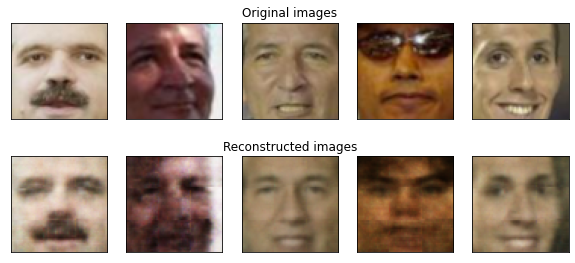

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 48/50 	 train loss 32.491 	 val loss 40.626


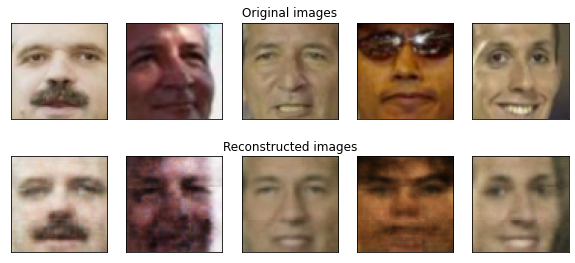

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 49/50 	 train loss 30.278 	 val loss 42.090


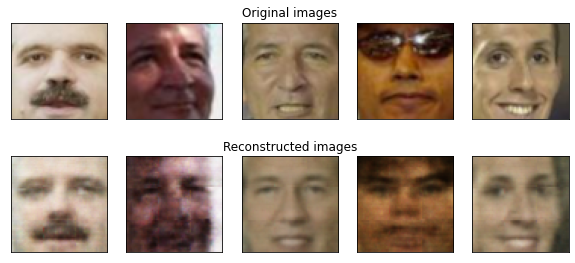

  0%|          | 0/83 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]


 EPOCH 50/50 	 train loss 29.838 	 val loss 43.902


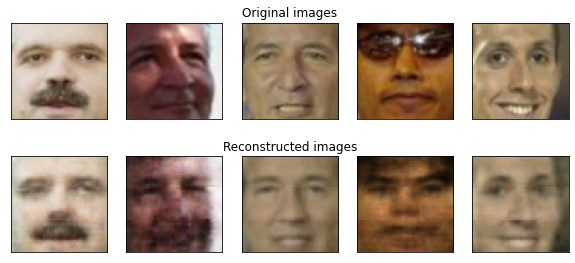

In [20]:
num_epochs = 50
train_losses = []
val_losses = []

for epoch in range(num_epochs):

#     clear_output(wait=True)

    train_loss = train(autoencoder,train_loader,criterion,optimizer)
    val_loss = test(autoencoder,val_loader, criterion)
    print('\n EPOCH {}/{} \t train loss {:.3f} \t val loss {:.3f}'.format(epoch + 1, num_epochs,train_loss,val_loss))
    train_losses.append(train_loss)
    val_losses.append(val_loss)

    plot_ae_outputs(autoencoder.encoder,autoencoder.decoder,val_photos,n=5)

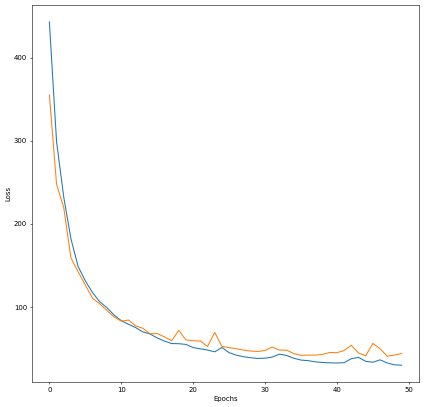

In [21]:
def plot_loss(train_loss, val_loss):
    plt.figure(figsize=(10,10),dpi=50)
    plt.plot(train_loss, label="train_loss", )
    plt.plot(val_loss, label="val_loss")
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.show()
    
plot_loss(train_losses,val_losses)

Давайте посмотрим, как наш тренированный автоэекодер кодирует и восстанавливает картинки:

In [22]:
autoencoder.eval()
with torch.no_grad():
    
    for batch in val_loader:
        batch = batch.to(device).float()
        reconstruction, latent = autoencoder(batch.view(-1,3,64,64))
        reconstruction = reconstruction.view(-1, 64, 64, 3)
    
        ground_truth = batch.detach().cpu().numpy()
        result = reconstruction.detach().cpu().numpy()
        break

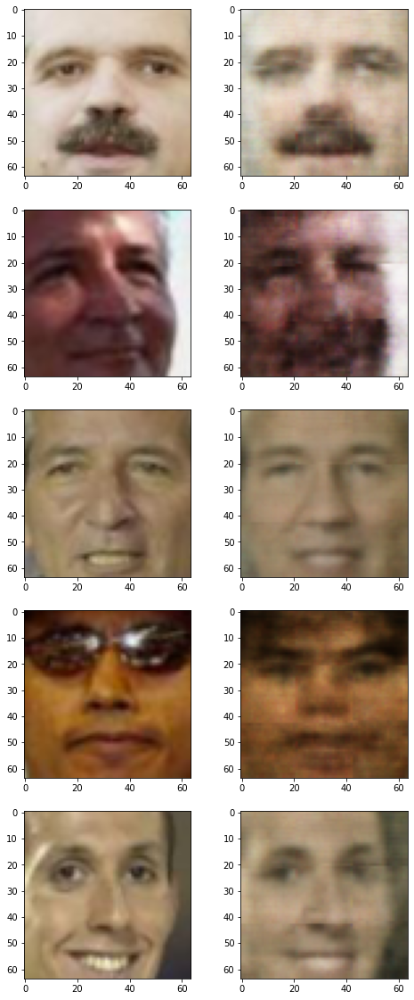

In [23]:
plt.figure(figsize=(8, 20))
for i, (gt, res) in enumerate(zip(ground_truth[:5], result[:5])):
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(gt)
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(res)

Not bad, right? 

## 1.4. Sampling (2 балла)

Давайте теперь будем не просто брать картинку, прогонять ее через автоэекодер и получать реконструкцию, а попробуем создать что-то НОВОЕ

Давайте возьмем и подсунем декодеру какие-нибудь сгенерированные нами векторы (например, из нормального распределения) и посмотрим на результат реконструкции декодера:

__Подсказка:__Е сли вместо лиц у вас выводится непонятно что, попробуйте посмотреть, как выглядят латентные векторы картинок из датасета. Так как в обучении нейронных сетей есть определенная доля рандома, векторы латентного слоя могут быть распределены НЕ как `np.random.randn(25, <latent_space_dim>)`. А чтобы у нас получались лица при запихивании вектора декодеру, вектор должен быть распределен так же, как латентные векторы реальных фоток. Так что в таком случае придется рандом немного подогнать.

In [24]:
lat_vecs = []
autoencoder.eval()
with torch.no_grad():
    for img in val_loader:
        img = img.to(device).float()
        img = img.view(-1, 3, 64, 64)
        rec, lat = autoencoder(img)
        lat_vecs.append(lat)
res = torch.cat(lat_vecs, dim=0)    

In [25]:
m = res.mean().detach().cpu().numpy() # mean
s = res.std().detach().cpu().numpy() # std

In [26]:
m

array(0.00057478, dtype=float32)

In [27]:
s

array(0.2838922, dtype=float32)

In [28]:
res.std()

tensor(0.2839, device='cuda:0')

In [29]:
# сгенерируем 25 рандомных векторов размера latent_space
z = torch.Tensor(np.random.normal(m, s, (25, 1024,1,1) )).to(device)
output = autoencoder.decoder(z)
output = output.view(-1, 64, 64, 3)

In [30]:
z[0].mean()

tensor(0.0049, device='cuda:0')

In [31]:
z[0].std()


tensor(0.2755, device='cuda:0')

#### Оба распределения похожи

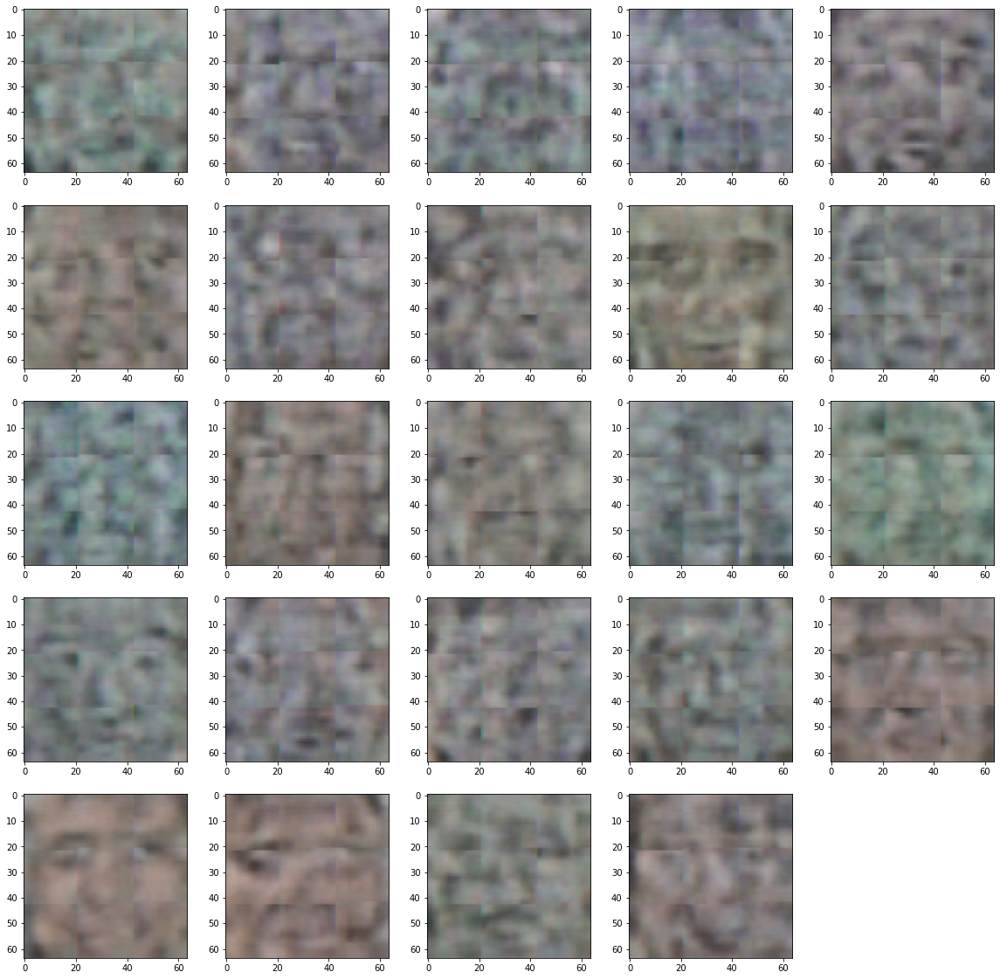

In [32]:
plt.figure(figsize=(20, 20))
for i in range(1,25):
    plt.subplot(5, 5, i)
    plt.imshow(output[i,:,:,:].detach().cpu().numpy())
    

## Time to make fun! (4 балла)

Давайте научимся пририсовывать людям улыбки =)

<img src="https://i.imgur.com/tOE9rDK.png" alt="linear" width="700" height="400">

План такой:

1. Нужно выделить "вектор улыбки": для этого нужно из выборки изображений найти несколько (~15) людей с улыбками и столько же без.

Найти людей с улыбками вам поможет файл с описанием датасета, скачанный вместе с датасетом. В нем указаны имена картинок и присутствубщие атрибуты (улыбки, очки...)

2. Вычислить латентный вектор для всех улыбающихся людей (прогнать их через encoder) и то же для всех грустненьких

3. Вычислить, собственно, вектор улыбки -- посчитать разность между средним латентным вектором улыбающихся людей и средним латентным вектором грустных людей

4. А теперь приделаем улыбку грустному человеку: добавим полученный в пункте 3 вектор к латентному вектору грустного человека и прогоним полученный вектор через decoder. Получим того же человека, но уже не грустненького!

In [33]:
happy = attrs[attrs['Smiling'] > 0.99].index
sad = attrs[attrs['Smiling'] < 0.1].index

In [34]:
happy_25 = list(happy[:25])
sad_25 = list(sad[:25])

In [35]:
print(f'Количество весеых:{len(happy_25)}')
print(f'Количество грустных:{len(sad_25)}')

Количество весеых:25
Количество грустных:25


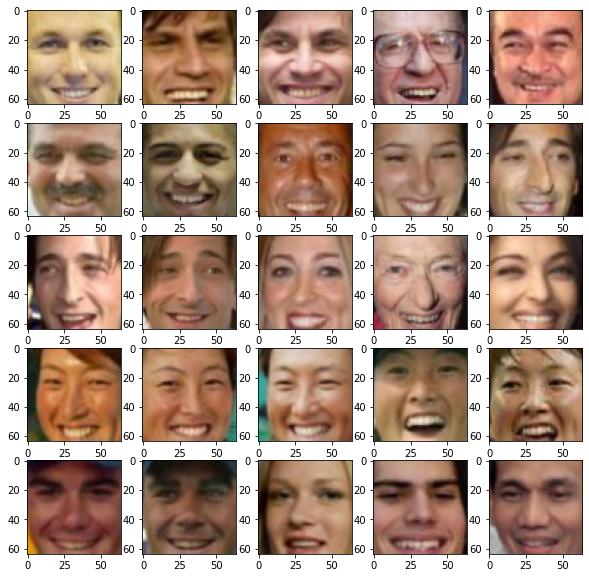

In [36]:
# Напечатаем веселых
plt.figure(figsize=(10,10)) 
for i,smile in enumerate(happy_25):
    plt.subplot(5,5,i+1)    # the number of images in the grid is 5*5 (25)
    plt.imshow(data[smile])

plt.show()

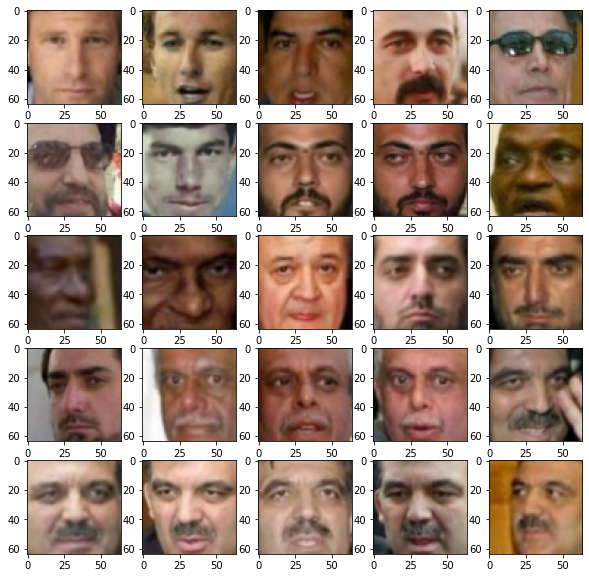

In [37]:
# Напечатаем  грустных
plt.figure(figsize=(10,10)) 
for i,smile in enumerate(sad_25):
    plt.subplot(5,5,i+1)    # the number of images in the grid is 5*5 (25)
    plt.imshow(data[smile])

plt.show()

In [38]:
smile_tensor = torch.Tensor(data[happy_25])
sad_tensor = torch.Tensor(data[sad_25])

In [39]:
# Прогоним их через энкодер и вычленим латентные вектора
pics_smile, latent_smile = autoencoder(smile_tensor.view(-1,3,64,64).to(device))
pics_sad, latent_sad = autoencoder(sad_tensor.view(-1,3,64,64).to(device))

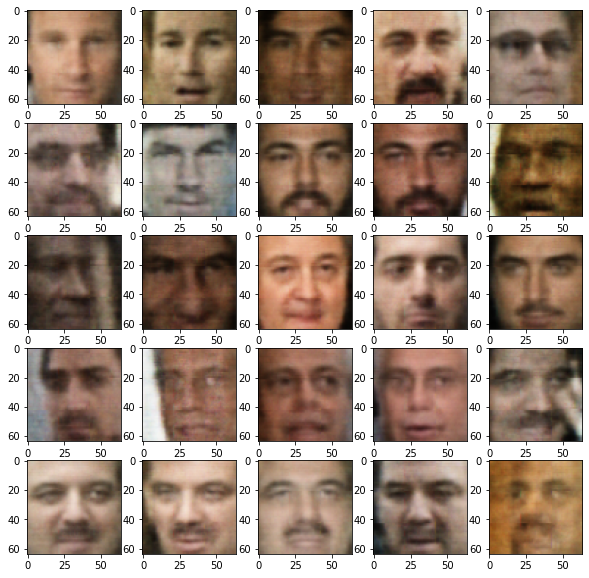

In [40]:
# Напечатаем реконструированные грусные лица
pics_sad = pics_sad.view(-1, 64, 64, 3)
pics_sad = pics_sad.detach().cpu().numpy()
plt.figure(figsize=(10,10)) 
for i in range(25):
    plt.subplot(5,5,i+1)    # the number of images in the grid is 5*5 (25)
    plt.imshow(pics_sad[i])

plt.show()

In [41]:
smile = latent_smile.mean(dim=0) - latent_sad.mean(dim=0) # Вектор улыбки

In [42]:
smiled_sad = latent_sad + smile # Грусть + улыбка

In [43]:
output = autoencoder.sample(smiled_sad)

In [44]:
output = output.detach().cpu().numpy()

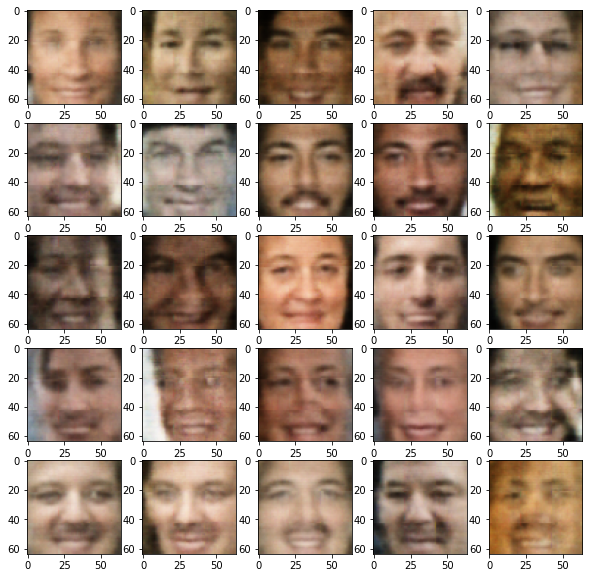

In [45]:
plt.figure(figsize=(10,10)) 
for i in range(25):
    plt.subplot(5,5,i+1)    # the number of images in the grid is 5*5 (25)
    plt.imshow(output[i])

plt.show()

Вуаля! Вы восхитительны!

Теперь вы можете пририсовывать людям не только улыбки, но и много чего другого -- закрывать/открывать глаза, пририсовывать очки... в общем, все, на что хватит фантазии и на что есть атрибуты в `all_attrs`:)

# Часть 2: Variational Autoencoder (10 баллов) 

Займемся обучением вариационных автоэнкодеров — проапгрейженной версии AE. Обучать будем на датасете MNIST, содержащем написанные от руки цифры от 0 до 9

In [46]:
batch_size = 32
# MNIST Dataset
train_dataset = datasets.MNIST(root='./mnist_data/', train=True, transform=transforms.ToTensor(), download=True)
test_dataset = datasets.MNIST(root='./mnist_data/', train=False, transform=transforms.ToTensor(), download=False)

# Data Loader (Input Pipeline)
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)

## 2.1 Архитектура модели и обучение (2 балла)

Реализуем VAE. Архитектуру (conv, fully-connected, ReLu, etc) можете выбирать сами. Рекомендуем пользоваться более сложными моделями, чем та, что была на семинаре:) Экспериментируйте!

In [47]:
class VariationalEncoder(nn.Module):
    def __init__(self, latent_dims):
        super(VariationalEncoder, self).__init__()
        self.conv1 = nn.Conv2d(1, 8, 3, stride=2, padding=1)
        # out_width = (28+2-5)/2+1 = 27/2+1 = 13
        self.conv2 = nn.Conv2d(8, 16, 3, stride=2, padding=1)
        self.batch2 = nn.BatchNorm2d(16)
        self.conv3 = nn.Conv2d(16, 32, 3, stride=2, padding=0)
        # out_width = (14-5)/2+1 = 5
        #self.drop1=nn.Dropout2d(p=0.3) 
        # 6 * 6 * 16 = 576
        self.linear1 = nn.Linear(3*3*32, 128)
        self.linear2 = nn.Linear(128, latent_dims)
        self.linear3 = nn.Linear(128, latent_dims)

        self.N = torch.distributions.Normal(0, 1)
        self.N.loc = self.N.loc.cuda() # hack to get sampling on the GPU
        self.N.scale = self.N.scale.cuda()
        self.kl = 0

    def forward(self, x):
        
        x = x.to(device)
        x = F.relu(self.conv1(x))
        x = F.relu(self.batch2(self.conv2(x)))
        x = F.relu(self.conv3(x))
       
        x = torch.flatten(x, start_dim=1)
     
        x = F.relu(self.linear1(x))
        mu =  self.linear2(x)
        sigma = torch.exp(self.linear3(x))
        z = mu + sigma*self.N.sample(mu.shape)
        self.kl = (sigma**2 + mu**2 - torch.log(sigma) - 1/2).sum()
        return z

In [48]:
class Decoder(nn.Module):
    
    def __init__(self, latent_dims):
        super().__init__()

        ### Linear section
        self.decoder_lin = nn.Sequential(
            # First linear layer
            nn.Linear(latent_dims, 128),
            nn.ReLU(True),
            # Second linear layer
            nn.Linear(128, 3 * 3 * 32),
            nn.ReLU(True)
        )

        ### Unflatten
        self.unflatten = nn.Unflatten(dim=1, unflattened_size=(32, 3, 3))

        ### Convolutional section
        self.decoder_conv = nn.Sequential(
            # First transposed convolution
            nn.ConvTranspose2d(32, 16, 3, stride=2, output_padding=0),
            nn.BatchNorm2d(16),
            nn.ReLU(True),
            # Second transposed convolution
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(8),
            nn.ReLU(True),
            # Third transposed convolution
            nn.ConvTranspose2d(8, 1, 3, stride=2, padding=1, output_padding=1)
        )
        
    def forward(self, x):
        # Apply linear layers
        x = self.decoder_lin(x)
        # Unflatten
        x = self.unflatten(x)
        # Apply transposed convolutions
        x = self.decoder_conv(x)
        # Apply a sigmoid to force the output to be between 0 and 1 (valid pixel values)
        x = torch.sigmoid(x)
        return x

In [49]:
class VariationalAutoencoder(nn.Module):
    def __init__(self, latent_dims):
        super(VariationalAutoencoder, self).__init__()
        self.encoder = VariationalEncoder(latent_dims)
        self.decoder = Decoder(latent_dims)

    def forward(self, x):
        x = x.to(device)
        z = self.encoder(x)
        return self.decoder(z)

Определим лосс и его компоненты для VAE:

Надеюсь, вы уже прочитали материал в towardsdatascience (или еще где-то) про VAE и знаете, что лосс у VAE состоит из двух частей: KL и log-likelihood.

Общий лосс будет выглядеть так:

$$\mathcal{L} = -D_{KL}(q_{\phi}(z|x)||p(z)) + \log p_{\theta}(x|z)$$

Формула для KL-дивергенции:

$$D_{KL} = -\frac{1}{2}\sum_{i=1}^{dimZ}(1+log(\sigma_i^2)-\mu_i^2-\sigma_i^2)$$

В качестве log-likelihood возьмем привычную нам кросс-энтропию.

In [50]:
# def KL_divergence(mu, logsigma):
#     """
#     часть функции потерь, которая отвечает за "близость" латентных представлений разных людей
#     """
#     loss = -0.5 * torch.sum(1 + logsigma - mu.pow(2) - logsigma.exp())
#     return 

def log_likelihood(x, reconstruction):
    """
    часть функции потерь, которая отвечает за качество реконструкции (как mse в обычном autoencoder)
    """
    loss = nn.BCELoss(reduction='sum')
    return loss(reconstruction, x)

# def loss_vae(x, mu, logsigma, reconstruction):
    # return  KL_divergence(mu, logsigma) + log_likelihood(x, reconstruction)

In [51]:
### Set the random seed for reproducible results
torch.manual_seed(0)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
d = 4

vae = VariationalAutoencoder(latent_dims=d).to(device)

lr = 1e-3 

optim = torch.optim.Adam(vae.parameters(), lr=lr, weight_decay=1e-5)


print(f'Selected device: {device}')

# vae.to(device)

Selected device: cuda


И обучим модель:

In [52]:
### Training function
def train_epoch(vae, device, dataloader, optimizer):
    # Set train mode for both the encoder and the decoder
    vae.train()
    train_loss = 0.0
    # Iterate the dataloader
    for x, _ in tqdm(dataloader): 
        # Move tensor to the proper device
        x = x.to(device)
        x_hat = vae(x)
        # Evaluate loss
        #BCE
        #loss = log_likelihood(x,x_hat) + vae.encoder.kl

        #MSE
        loss = ((x - x_hat)**2).sum() + vae.encoder.kl

        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        #print('\t partial train loss (single batch): %f' % (loss.item()))
        train_loss+=loss.item()

    return train_loss / len(dataloader.dataset)

In [53]:
### Testing function
def test_epoch(vae, device, dataloader):
    # Set evaluation mode for encoder and decoder
    vae.eval()
    val_loss = 0.0
    with torch.no_grad(): # No need to track the gradients
        for x, _ in tqdm(dataloader):
            # Move tensor to the proper device
            x = x.to(device)
            # Encode data
            encoded_data = vae.encoder(x)
            # Decode data
            x_hat = vae(x)
            loss = ((x - x_hat)**2).sum() + vae.encoder.kl
            #loss = log_likelihood(x,x_hat) + vae.encoder.kl
            val_loss += loss.item()

    return val_loss / len(dataloader.dataset)

In [54]:
def plot_ae_outputs(encoder,decoder,n=5):
    plt.figure(figsize=(10,4.5))
    for i in range(n):
        
        ax = plt.subplot(2,n,i+1)
        img = test_dataset[i][0].unsqueeze(0).to(device)
        encoder.eval()
        decoder.eval()
        with torch.no_grad():
            rec_img  = decoder(encoder(img))
        plt.imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)  
        if i == n//2:
            ax.set_title('Original images')
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')  
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)  
        if i == n//2:
            
            ax.set_title('Reconstructed images')
    plt.show()

Давайте посмотрим, как наш тренированный VAE кодирует и восстанавливает картинки:

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 1/15 	 train loss 54.946 	 val loss 36.701


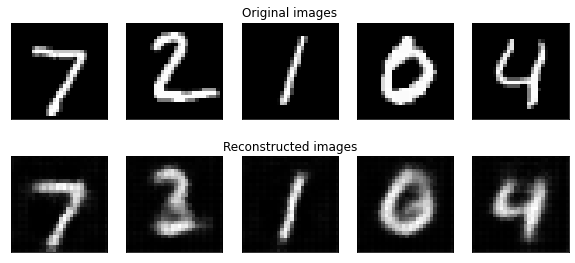

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 2/15 	 train loss 35.994 	 val loss 35.164


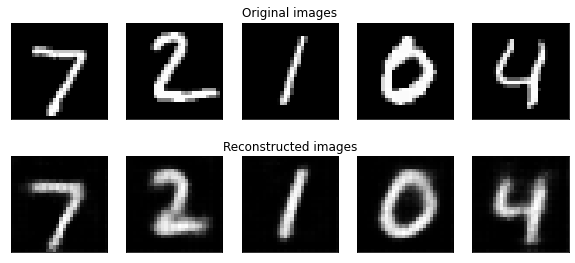

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 3/15 	 train loss 34.954 	 val loss 34.475


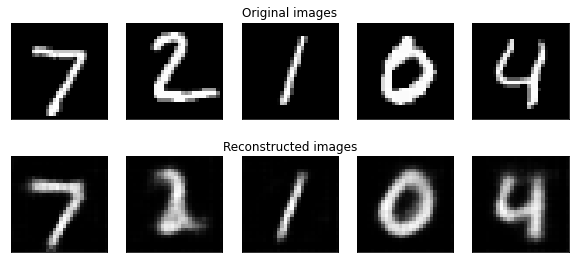

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 4/15 	 train loss 34.414 	 val loss 34.170


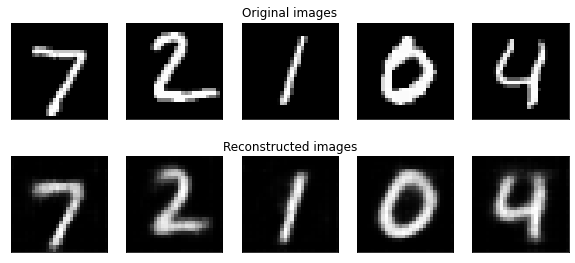

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 5/15 	 train loss 34.092 	 val loss 33.746


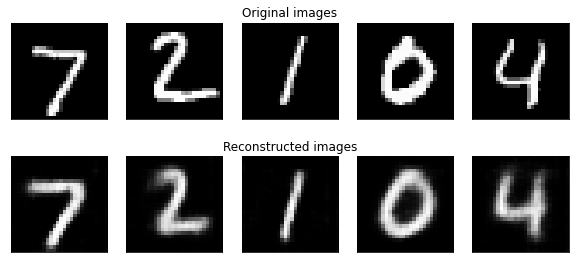

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 6/15 	 train loss 33.801 	 val loss 33.590


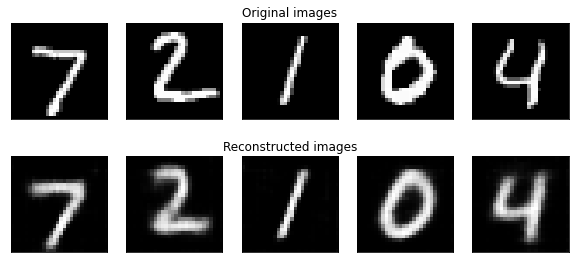

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 7/15 	 train loss 33.620 	 val loss 33.491


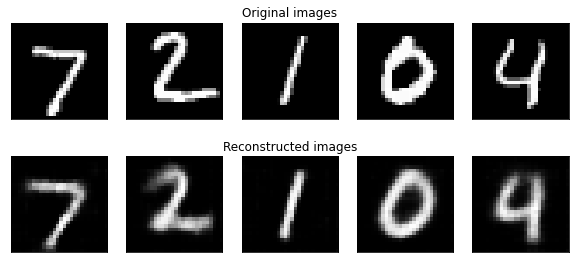

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 8/15 	 train loss 33.468 	 val loss 33.138


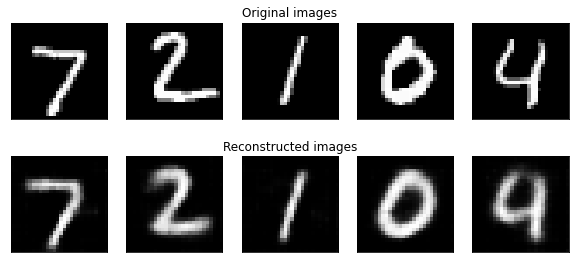

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 9/15 	 train loss 33.288 	 val loss 33.103


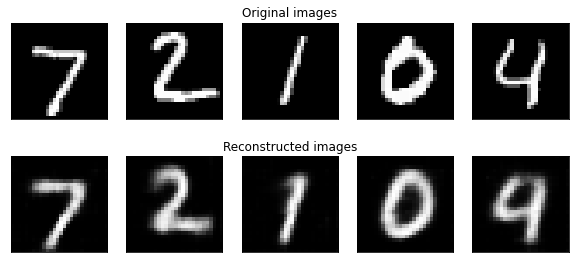

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 10/15 	 train loss 33.182 	 val loss 32.925


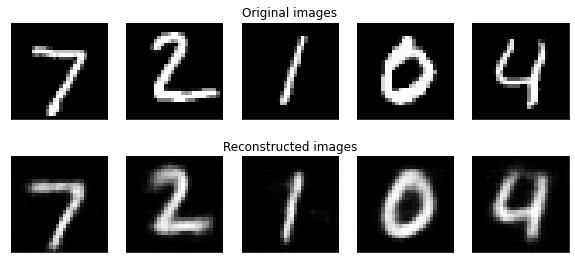

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 11/15 	 train loss 33.032 	 val loss 33.057


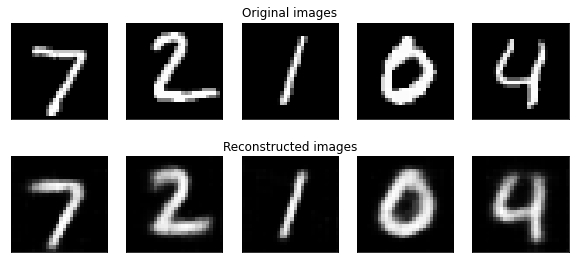

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 12/15 	 train loss 32.916 	 val loss 32.729


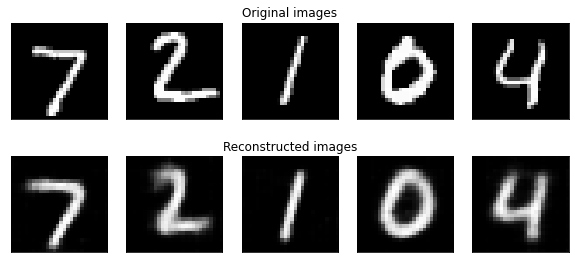

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 13/15 	 train loss 32.852 	 val loss 32.905


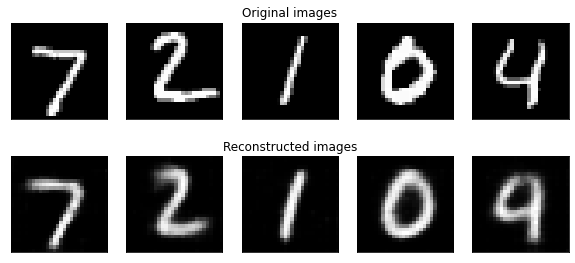

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 14/15 	 train loss 32.778 	 val loss 32.666


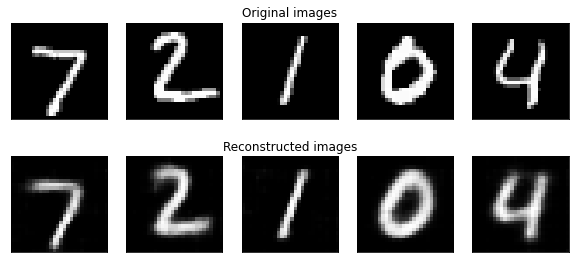

  0%|          | 0/1875 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]


 EPOCH 15/15 	 train loss 32.690 	 val loss 32.556


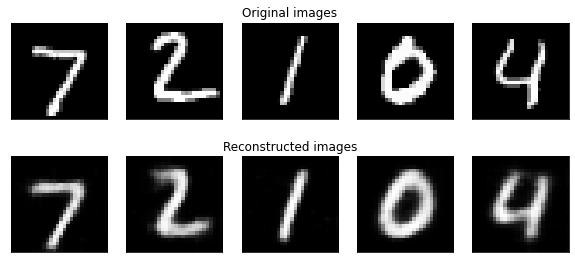

In [55]:
num_epochs = 15
for epoch in range(num_epochs):
    train_loss = train_epoch(vae,device,train_loader,optim)
    val_loss = test_epoch(vae,device,test_loader)
    print('\n EPOCH {}/{} \t train loss {:.3f} \t val loss {:.3f}'.format(epoch + 1, num_epochs,train_loss,val_loss))

    plot_ae_outputs(vae.encoder,vae.decoder,n=5)

In [56]:
# < тут Ваш код: выведите первые Х картинок и их реконструкций из val выборки на экран>
vae.eval()
with torch.no_grad():    
    for batch, _ in test_loader:        
        batch = batch.to(device).float()
        reconstruction = vae(batch)
        reconstruction = reconstruction.view(-1, 28, 28)
        result = reconstruction.detach().cpu().numpy()

        ground_truth = batch.detach().cpu().numpy()
        ground_truth = np.reshape(ground_truth,(-1,28,28))
        break

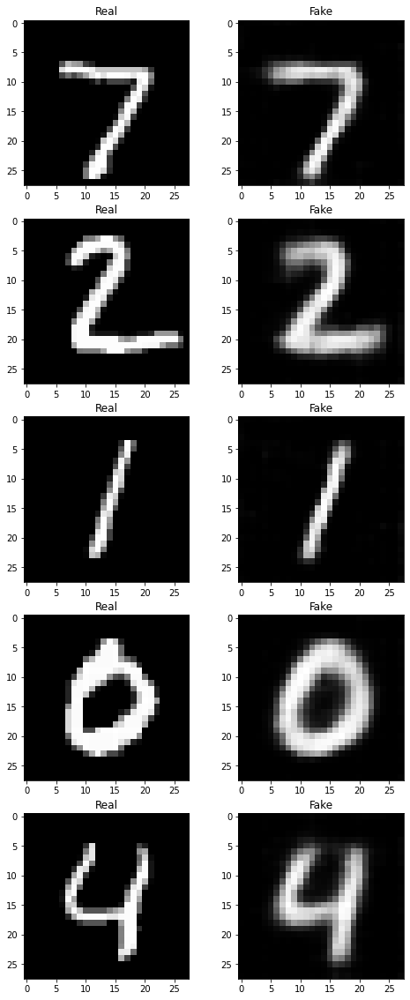

In [57]:
plt.figure(figsize=(8, 20))
for i, (gt, res) in enumerate(zip(ground_truth[:5], result[:5])):
    
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(gt, cmap='gray')
    plt.title('Real')
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(res,cmap='gray')
    plt.title('Fake')

Давайте попробуем проделать для VAE то же, что и с обычным автоэнкодером -- подсунуть decoder'у из VAE случайные векторы из нормального распределения и посмотреть, какие картинки получаются:

In [58]:
# вспомните про замечание из этого же пункта обычного AE про распределение латентных переменных
z = np.array([np.random.normal(0, 1, d) for i in range(8)])
z = torch.Tensor(z).to(device)
z.shape
output = vae.decoder(z)
output.shape

torch.Size([8, 1, 28, 28])

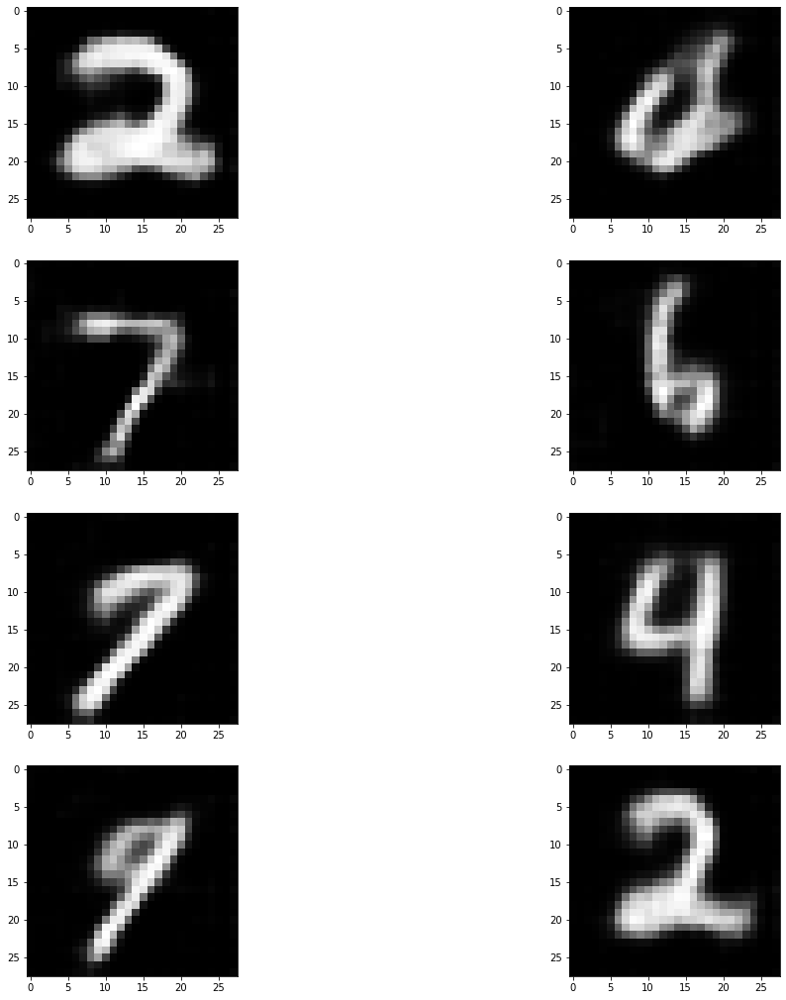

In [59]:
plt.figure(figsize=(18, 18))
for i in range(output.shape[0]):
    plt.subplot(output.shape[0] // 2, 2, i + 1)
    generated = output[i].cpu().detach().numpy()
    plt.imshow(generated[0],cmap='gray')

plt.show()

## 2.2. Latent Representation (2 балла)

Давайте посмотрим, как латентные векторы картинок лиц выглядят в пространстве.
Ваша задача -- изобразить латентные векторы картинок точками в двумерном просторанстве. 

Это позволит оценить, насколько плотно распределены латентные векторы изображений цифр в пространстве. 

Плюс давайте сделаем такую вещь: покрасим точки, которые соответствуют картинкам каждой цифры, в свой отдельный цвет

Подсказка: красить -- это просто =) У plt.scatter есть параметр c (color), см. в документации.


Итак, план:
1. Получить латентные представления картинок тестового датасета
2. С помощтю `TSNE` (есть в `sklearn`) сжать эти представления до размерности 2 (чтобы можно было их визуализировать точками в пространстве)
3. Визуализировать полученные двумерные представления с помощью `matplotlib.scatter`, покрасить разными цветами точки, соответствующие картинкам разных цифр.

In [60]:
encoded_samples = []
for sample in tqdm(test_dataset):
    img = sample[0].unsqueeze(0).to(device)
    label = sample[1]
    # Encode image
    vae.eval()
    with torch.no_grad():
        encoded_img  = vae.encoder(img)
    # Append to list
    encoded_img = encoded_img.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}
    encoded_sample['label'] = label
    encoded_samples.append(encoded_sample)
    
encoded_samples = pd.DataFrame(encoded_samples)
encoded_samples

  0%|          | 0/10000 [00:00<?, ?it/s]

,Enc. Variable 0,Enc. Variable 1,Enc. Variable 2,Enc. Variable 3,label
0,1.571920,-0.662516,0.021820,-0.932740,7
1,-0.895492,-0.044734,-0.207293,-1.412682,2
2,0.309418,-0.031311,-0.588426,-1.405626,1
3,-0.041719,0.428998,-0.409912,1.112012,0
4,0.785899,-0.326219,-0.423700,0.732030,4
...,...,...,...,...,...
9995,-1.603657,0.581465,0.841644,-0.797993,2
9996,-1.304492,-0.333720,-0.377203,0.285504,3
9997,0.853976,0.376073,-0.353499,-0.208377,4
9998,0.363828,1.000491,-0.070024,-0.065818,5


In [61]:
from sklearn.manifold import TSNE
import plotly.express as px

px.scatter(encoded_samples,
           x='Enc. Variable 0', 
           y='Enc. Variable 1',
           color=encoded_samples.label.astype(str), 
           opacity=0.7)

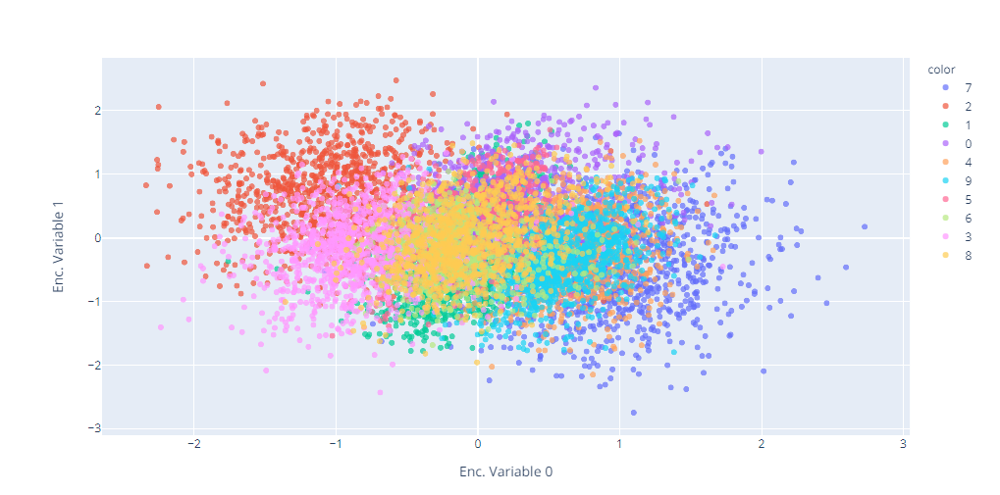

In [62]:
tsne = TSNE(n_components=2)
tsne_results = tsne.fit_transform(encoded_samples.drop(['label'],axis=1))

fig = px.scatter(tsne_results,
                 x=0,
                 y=1,
                 color=encoded_samples.label.astype(str),
                 labels={'0': 'tsne-2d-one', '1': 'tsne-2d-two'})
fig.show()

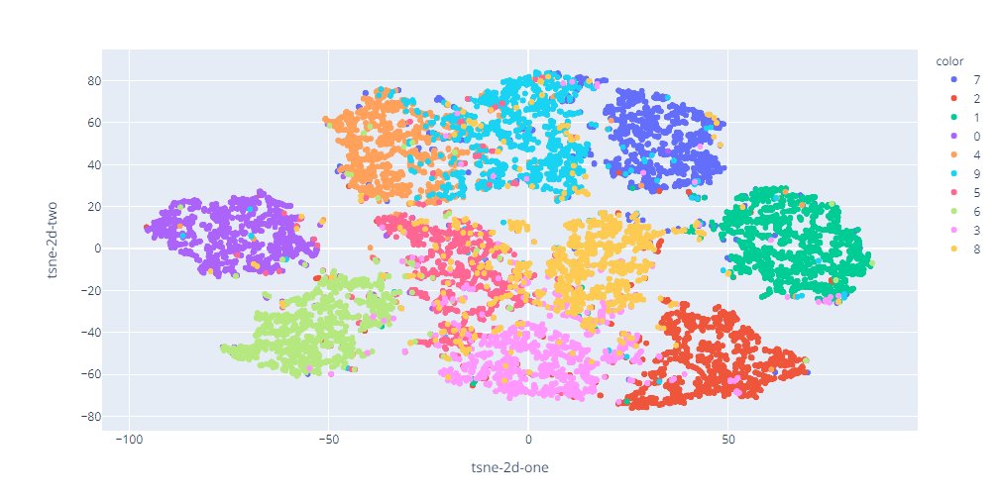

Что вы думаете о виде латентного представления?

Красивое

__Congrats v2.0!__

## 2.3. Conditional VAE (6 баллов)


Мы уже научились обучать обычный AE на датасете картинок и получать новые картинки, используя генерацию шума и декодер. 
Давайте теперь допустим, что мы обучили AE на датасете MNIST и теперь хотим генерировать новые картинки с числами с помощью декодера (как выше мы генерили рандомные лица). 
И вот нам понадобилось сгенерировать цифру 8, и мы подставляем разные варианты шума, но восьмерка никак не генерится:(

Хотелось бы добавить к нашему AE функцию "выдай мне рандомное число из вот этого вот класса", где классов десять (цифры от 0 до 9 образуют десять классов).  Conditional AE — так называется вид автоэнкодера, который предоставляет такую возможность. Ну, название "conditional" уже говорит само за себя.

И в этой части задания мы научимся такие обучать.

### Архитектура

На картинке ниже представлена архитектура простого Conditional VAE.

По сути, единственное отличие от обычного -- это то, что мы вместе с картинкой в первом слое энкодера и декодера передаем еще информацию о классе картинки. 

То есть, в первый (входной) слой энкодера подается конкатенация картинки и информации о классе (например, вектора из девяти нулей и одной единицы). В первый слой декодера подается конкатенация латентного вектора и информации о классе.


![alt text](https://sun9-63.userapi.com/impg/Mh1akf7mfpNoprrSWsPOouazSmTPMazYYF49Tw/djoHNw_9KVA.jpg?size=1175x642&quality=96&sign=e88baec5f9bb91c8443fba31dcf0a4df&type=album)

![alt text](https://sun9-73.userapi.com/impg/UDuloLNKhzTBYAKewgxke5-YPsAKyGOqA-qCRg/MnyCavJidxM.jpg?size=1229x651&quality=96&sign=f2d21bfacc1c5755b76868dc4cfef39c&type=album)



На всякий случай: это VAE, то есть, latent у него все еще состоит из mu и sigma

Таким образом, при генерации новой рандомной картинки мы должны будем передать декодеру сконкатенированные латентный вектор и класс картинки.

P.S. Также можно передавать класс картинки не только в первый слой, но и в каждый слой сети. То есть на каждом слое конкатенировать выход из предыдущего слоя и информацию о классе.

In [66]:
batch_size = 64
latent_size = 20
epochs = 50


train_loader = torch.utils.data.DataLoader(
    datasets.MNIST('../data', train=True, download=True,
                   transform=transforms.ToTensor()),
    batch_size=batch_size, shuffle=True, )

test_loader = torch.utils.data.DataLoader(
    datasets.MNIST('../data', train=False, transform=transforms.ToTensor()),
    batch_size=batch_size, shuffle=False, )


In [67]:
def one_hot(labels, class_size):
    targets = torch.zeros(labels.size(0), class_size)
    for i, label in enumerate(labels):
        targets[i, label] = 1
    return targets.to(device)


In [103]:
class CVAE(nn.Module):
    def __init__(self, feature_size, latent_size, class_size):
        super(CVAE, self).__init__()
        self.feature_size = feature_size
        self.class_size = class_size

        # encode
        self.fc1  = nn.Linear(feature_size + class_size, 400)
        self.fc21 = nn.Linear(400, latent_size)
        self.fc22 = nn.Linear(400, latent_size)

        # decode
        self.fc3 = nn.Linear(latent_size + class_size, 400)
        self.fc4 = nn.Linear(400, feature_size)

        self.elu = nn.ELU()
        self.sigmoid = nn.Sigmoid()

    def encode(self, x, c): # Q(z|x, c)
        '''
        x: (bs, feature_size)
        c: (bs, class_size)
        '''
        inputs = torch.cat([x, c], 1) # (bs, feature_size+class_size)
        h1 = self.elu(self.fc1(inputs))
        z_mu = self.fc21(h1)
        z_var = self.fc22(h1)
        return z_mu, z_var

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std

    def decode(self, z, c): # P(x|z, c)
        '''
        z: (bs, latent_size)
        c: (bs, class_size)
        '''
#         print(z.shape)
#         print(c.shape)
        inputs = torch.cat([z, c], 1) # (bs, latent_size+class_size)
        h3 = self.elu(self.fc3(inputs))
        return self.sigmoid(self.fc4(h3))

    def forward(self, x, c):
        mu, logvar = self.encode(x.view(-1, 28*28), c)
        z = self.reparameterize(mu, logvar)
        return self.decode(z, c), mu, logvar

In [104]:
model = CVAE(28*28, latent_size, 10).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)


In [105]:
def loss_function(recon_x, x, mu, logvar):
    BCE = F.binary_cross_entropy(recon_x, x.view(-1, 784), reduction='sum')
    # see Appendix B from VAE paper:
    # Kingma and Welling. Auto-Encoding Variational Bayes. ICLR, 2014
    # https://arxiv.org/abs/1312.6114
    # 0.5 * sum(1 + log(sigma^2) - mu^2 - sigma^2)
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return BCE + KLD

In [106]:
def train(epoch):
    model.train()
    train_loss = 0
    for batch_idx, (data, labels) in tqdm(enumerate(train_loader)):
        data, labels = data.to(device), labels.to(device)
        labels = one_hot(labels, 10)
        recon_batch, mu, logvar = model(data, labels)
        optimizer.zero_grad()
        loss = loss_function(recon_batch, data, mu, logvar)
        loss.backward()
        train_loss += loss.detach().cpu().numpy()
        optimizer.step()
        

    print('====> Epoch: {} Average loss: {:.4f}'.format(
          epoch, train_loss / len(train_loader.dataset)))
    return train_loss / len(train_loader.dataset)

In [107]:
def test(epoch):
    model.eval()
    test_loss = 0
    with torch.no_grad():
        for i, (data, labels) in tqdm(enumerate(test_loader)):
            data, labels = data.to(device), labels.to(device)
            labels = one_hot(labels, 10)
            recon_batch, mu, logvar = model(data, labels)
            test_loss += loss_function(recon_batch, data, mu, logvar).detach().cpu().numpy()
            if i == 0:
                n = min(data.size(0), 5)
                comparison = torch.cat([data[:n],
                                      recon_batch.view(-1, 1, 28, 28)[:n]])
                

    test_loss / len(test_loader.dataset)
    print('====> Test set loss: {:.4f}'.format(test_loss))
    return test_loss / len(test_loader.dataset)

  0%|          | 0/50 [00:00<?, ?it/s]

0it [00:00, ?it/s]

====> Epoch: 1 Average loss: 144.1264


0it [00:00, ?it/s]

====> Test set loss: 1195935.2922


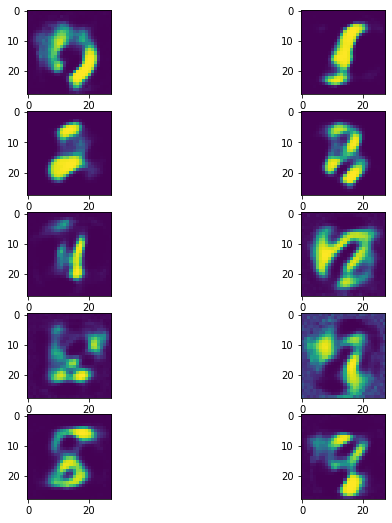

0it [00:00, ?it/s]

====> Epoch: 2 Average loss: 116.7246


0it [00:00, ?it/s]

====> Test set loss: 1125489.9375


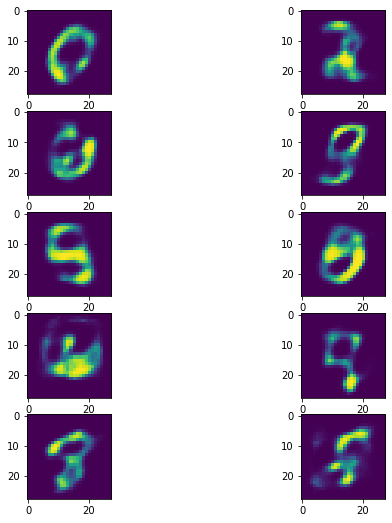

0it [00:00, ?it/s]

====> Epoch: 3 Average loss: 111.5385


0it [00:00, ?it/s]

====> Test set loss: 1091970.6074


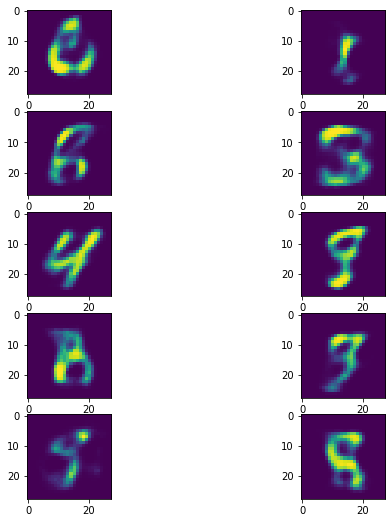

0it [00:00, ?it/s]

====> Epoch: 4 Average loss: 108.5427


0it [00:00, ?it/s]

====> Test set loss: 1066846.6670


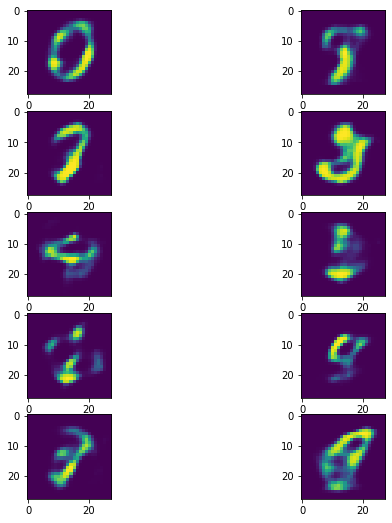

0it [00:00, ?it/s]

====> Epoch: 5 Average loss: 106.6610


0it [00:00, ?it/s]

====> Test set loss: 1054142.3937


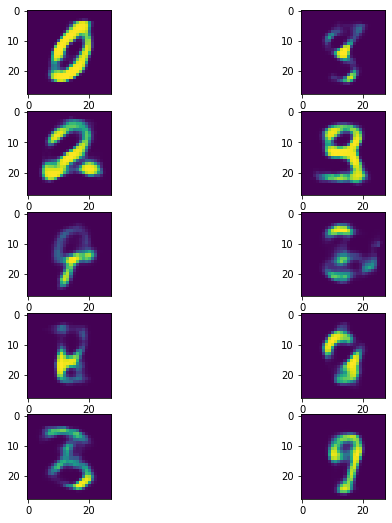

0it [00:00, ?it/s]

====> Epoch: 6 Average loss: 105.3800


0it [00:00, ?it/s]

====> Test set loss: 1046191.2690


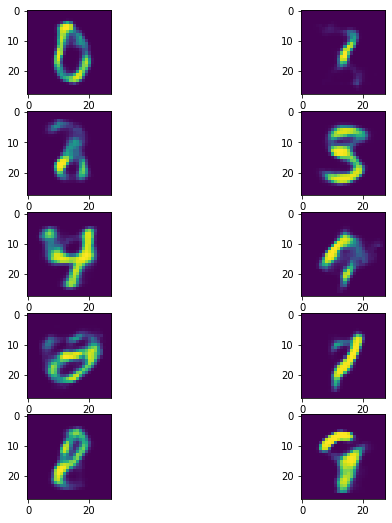

0it [00:00, ?it/s]

====> Epoch: 7 Average loss: 104.4295


0it [00:00, ?it/s]

====> Test set loss: 1034793.5775


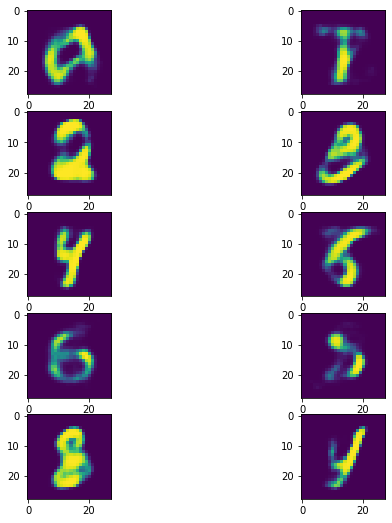

0it [00:00, ?it/s]

====> Epoch: 8 Average loss: 103.6594


0it [00:00, ?it/s]

====> Test set loss: 1027927.0195


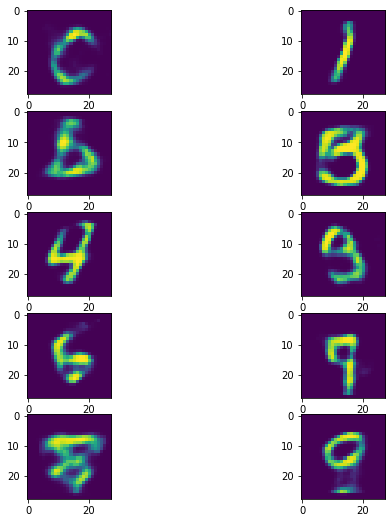

0it [00:00, ?it/s]

====> Epoch: 9 Average loss: 103.0857


0it [00:00, ?it/s]

====> Test set loss: 1025299.4880


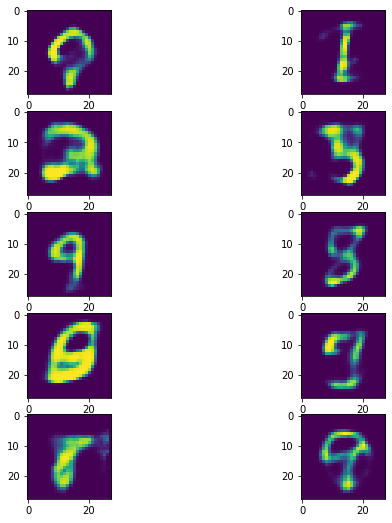

0it [00:00, ?it/s]

====> Epoch: 10 Average loss: 102.5699


0it [00:00, ?it/s]

====> Test set loss: 1023472.3584


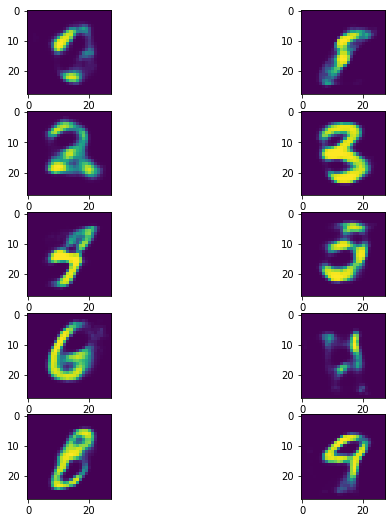

0it [00:00, ?it/s]

====> Epoch: 11 Average loss: 102.1545


0it [00:00, ?it/s]

====> Test set loss: 1016830.9851


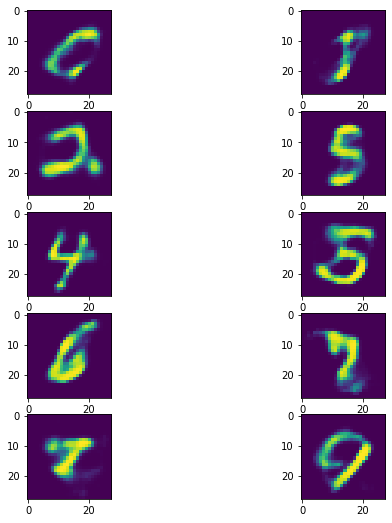

0it [00:00, ?it/s]

====> Epoch: 12 Average loss: 101.7866


0it [00:00, ?it/s]

====> Test set loss: 1013411.4260


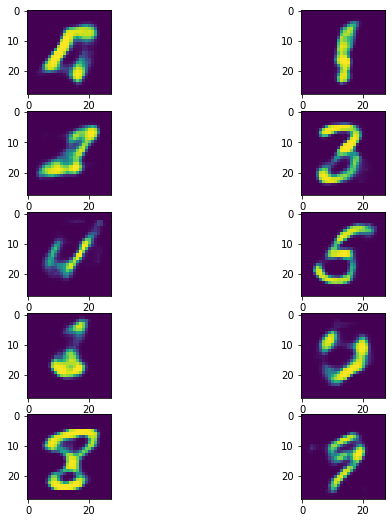

0it [00:00, ?it/s]

====> Epoch: 13 Average loss: 101.5109


0it [00:00, ?it/s]

====> Test set loss: 1009256.0596


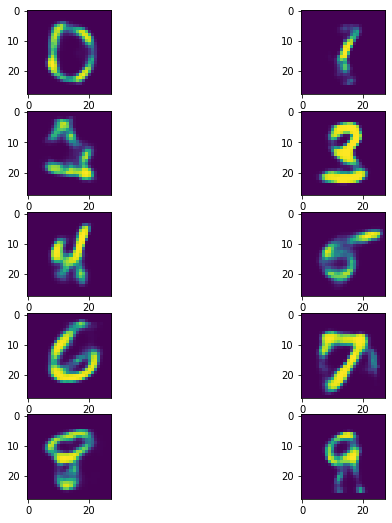

0it [00:00, ?it/s]

====> Epoch: 14 Average loss: 101.1822


0it [00:00, ?it/s]

====> Test set loss: 1008086.3492


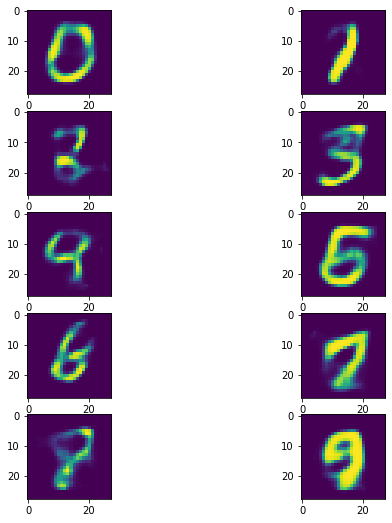

0it [00:00, ?it/s]

====> Epoch: 15 Average loss: 100.9381


0it [00:00, ?it/s]

====> Test set loss: 1010217.2778


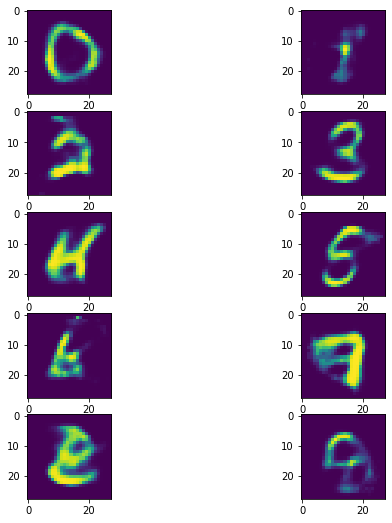

0it [00:00, ?it/s]

====> Epoch: 16 Average loss: 100.7198


0it [00:00, ?it/s]

====> Test set loss: 1010684.5487


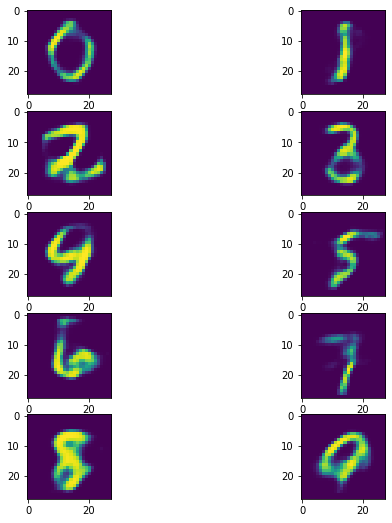

0it [00:00, ?it/s]

====> Epoch: 17 Average loss: 100.5283


0it [00:00, ?it/s]

====> Test set loss: 999955.5999


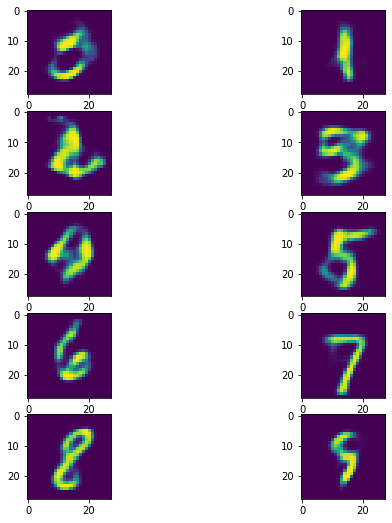

0it [00:00, ?it/s]

====> Epoch: 18 Average loss: 100.3358


0it [00:00, ?it/s]

====> Test set loss: 998011.7412


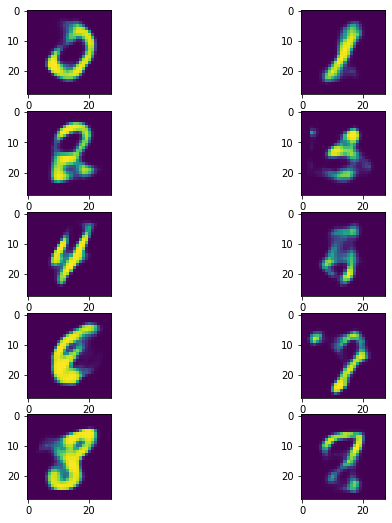

0it [00:00, ?it/s]

====> Epoch: 19 Average loss: 100.1750


0it [00:00, ?it/s]

====> Test set loss: 998281.7031


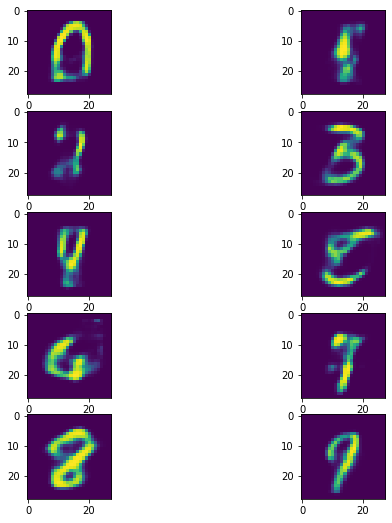

0it [00:00, ?it/s]

====> Epoch: 20 Average loss: 99.9219


0it [00:00, ?it/s]

====> Test set loss: 1004176.1135


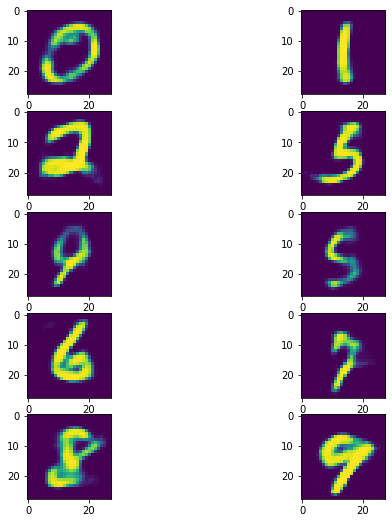

0it [00:00, ?it/s]

====> Epoch: 21 Average loss: 99.8124


0it [00:00, ?it/s]

====> Test set loss: 995287.4368


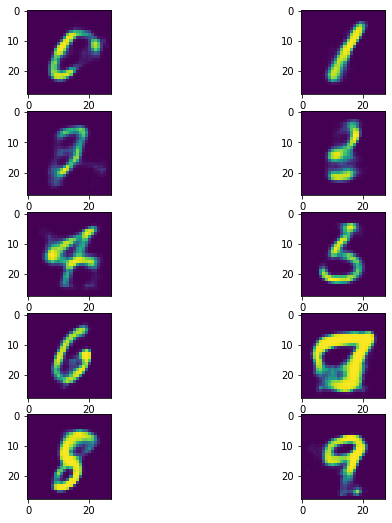

0it [00:00, ?it/s]

====> Epoch: 22 Average loss: 99.6684


0it [00:00, ?it/s]

====> Test set loss: 994541.7437


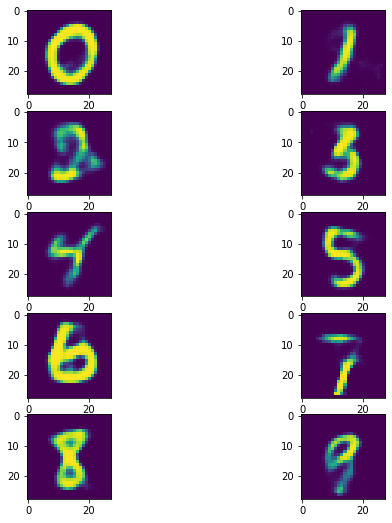

0it [00:00, ?it/s]

====> Epoch: 23 Average loss: 99.5503


0it [00:00, ?it/s]

====> Test set loss: 995611.3499


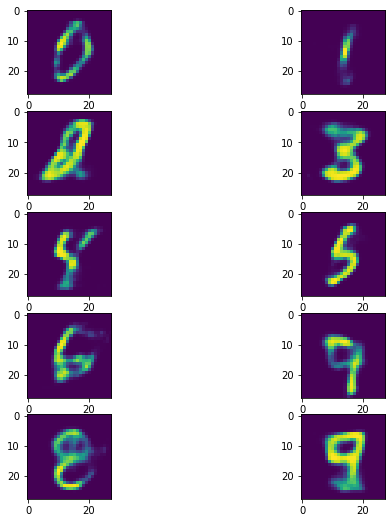

0it [00:00, ?it/s]

====> Epoch: 24 Average loss: 99.3920


0it [00:00, ?it/s]

====> Test set loss: 993176.6752


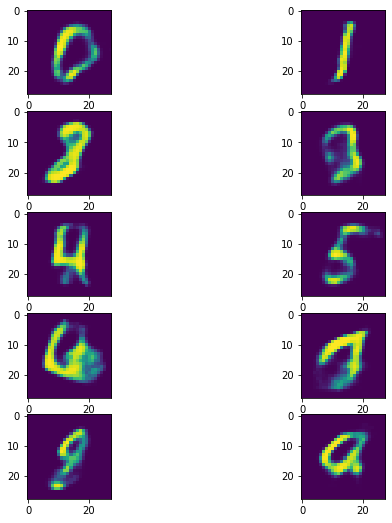

0it [00:00, ?it/s]

====> Epoch: 25 Average loss: 99.2859


0it [00:00, ?it/s]

====> Test set loss: 991434.8917


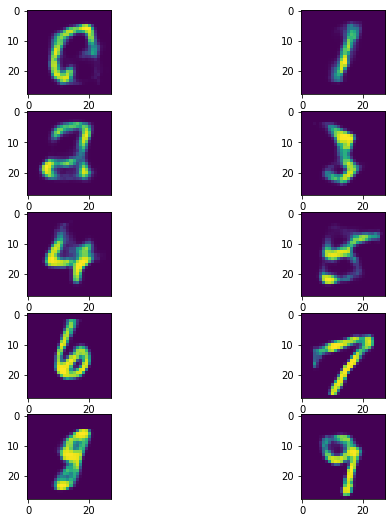

0it [00:00, ?it/s]

====> Epoch: 26 Average loss: 99.2055


0it [00:00, ?it/s]

====> Test set loss: 990069.5782


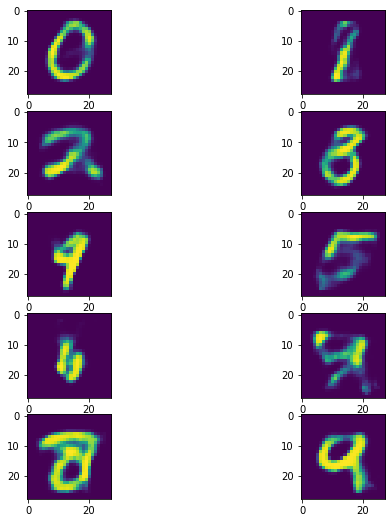

0it [00:00, ?it/s]

====> Epoch: 27 Average loss: 99.0712


0it [00:00, ?it/s]

====> Test set loss: 989913.0480


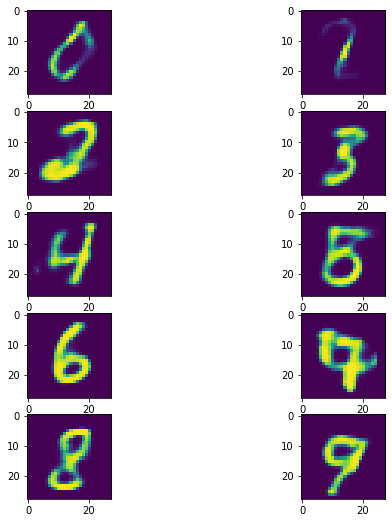

0it [00:00, ?it/s]

====> Epoch: 28 Average loss: 98.9881


0it [00:00, ?it/s]

====> Test set loss: 987095.3575


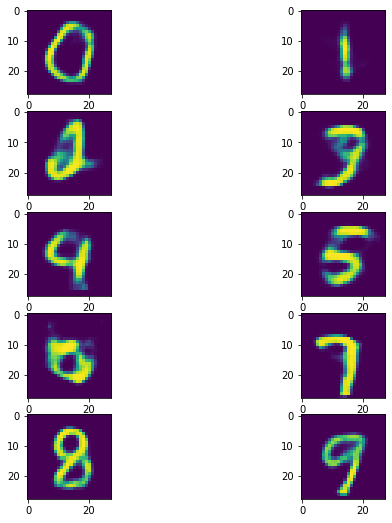

0it [00:00, ?it/s]

====> Epoch: 29 Average loss: 98.8751


0it [00:00, ?it/s]

====> Test set loss: 988942.3718


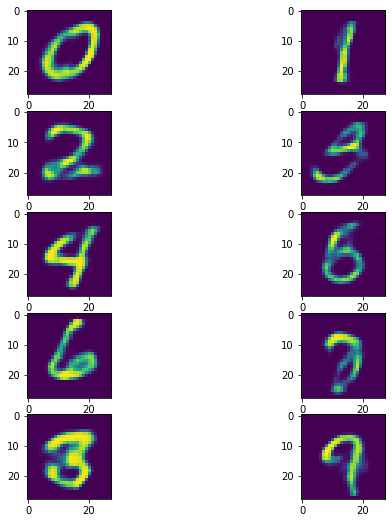

0it [00:00, ?it/s]

====> Epoch: 30 Average loss: 98.7356


0it [00:00, ?it/s]

====> Test set loss: 985278.4651


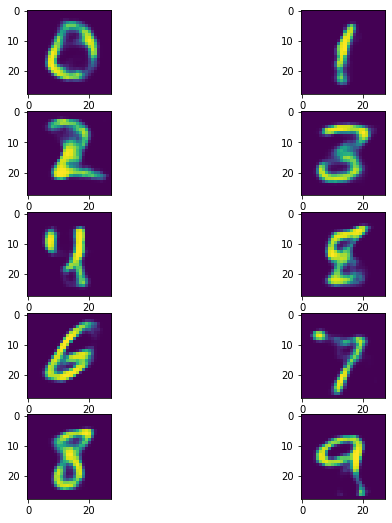

0it [00:00, ?it/s]

====> Epoch: 31 Average loss: 98.6298


0it [00:00, ?it/s]

====> Test set loss: 986825.8801


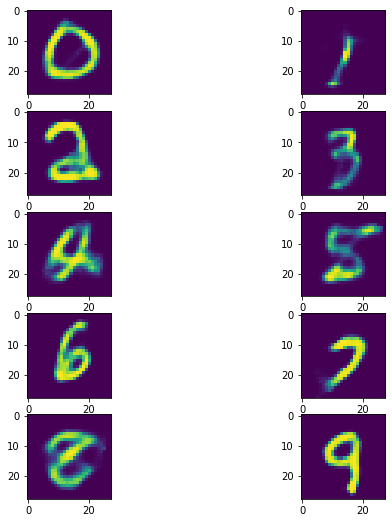

0it [00:00, ?it/s]

====> Epoch: 32 Average loss: 98.5814


0it [00:00, ?it/s]

====> Test set loss: 985764.5417


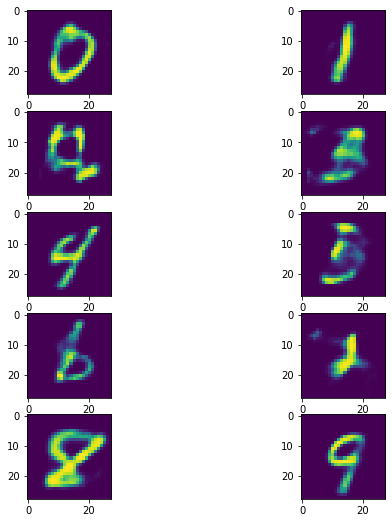

0it [00:00, ?it/s]

====> Epoch: 33 Average loss: 98.5065


0it [00:00, ?it/s]

====> Test set loss: 986368.5491


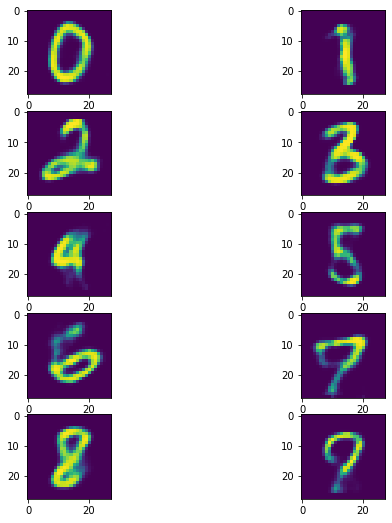

0it [00:00, ?it/s]

====> Epoch: 34 Average loss: 98.4417


0it [00:00, ?it/s]

====> Test set loss: 983439.3483


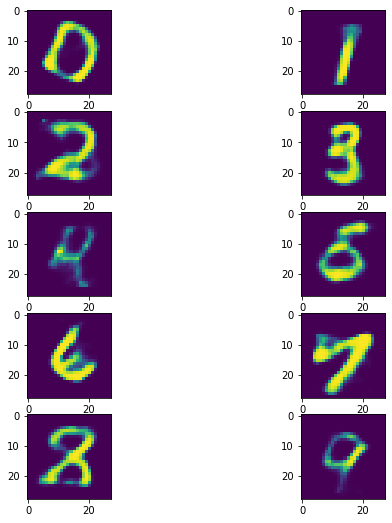

0it [00:00, ?it/s]

====> Epoch: 35 Average loss: 98.2998


0it [00:00, ?it/s]

====> Test set loss: 983600.6359


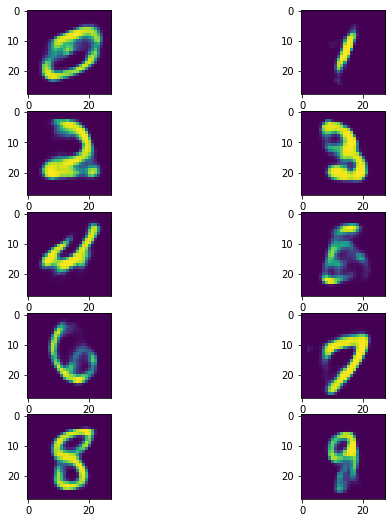

0it [00:00, ?it/s]

====> Epoch: 36 Average loss: 98.2353


0it [00:00, ?it/s]

====> Test set loss: 984297.7948


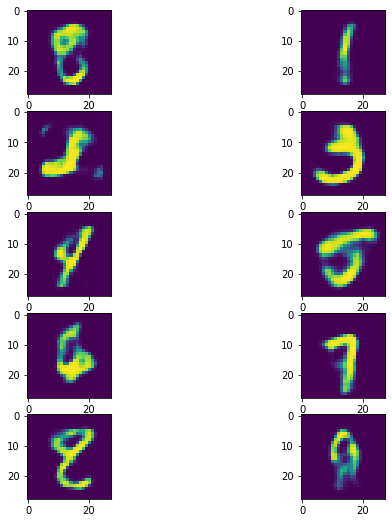

0it [00:00, ?it/s]

====> Epoch: 37 Average loss: 98.1899


0it [00:00, ?it/s]

====> Test set loss: 987025.9316


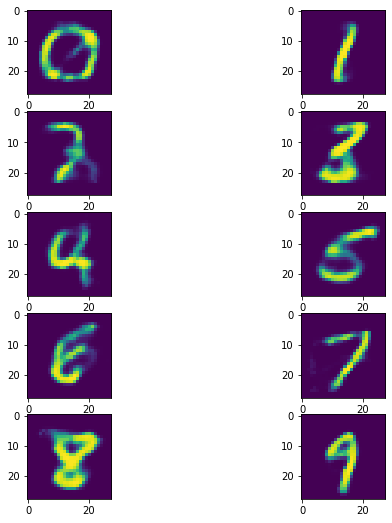

0it [00:00, ?it/s]

====> Epoch: 38 Average loss: 98.1447


0it [00:00, ?it/s]

====> Test set loss: 980229.9282


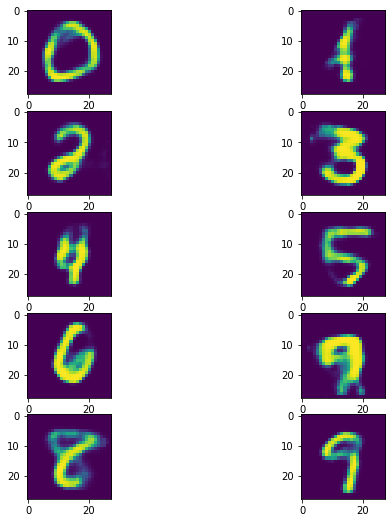

0it [00:00, ?it/s]

====> Epoch: 39 Average loss: 98.0283


0it [00:00, ?it/s]

====> Test set loss: 981830.4790


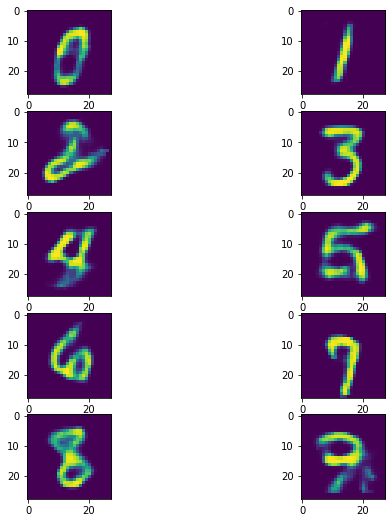

0it [00:00, ?it/s]

====> Epoch: 40 Average loss: 97.9987


0it [00:00, ?it/s]

====> Test set loss: 983328.6510


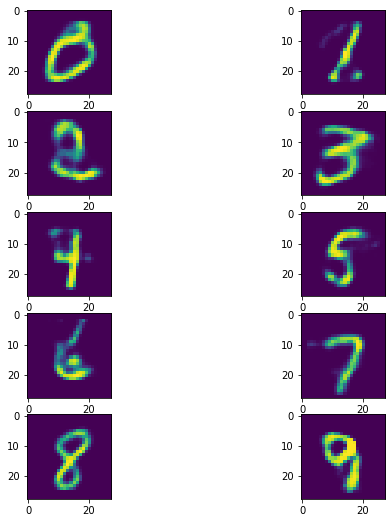

0it [00:00, ?it/s]

====> Epoch: 41 Average loss: 97.9377


0it [00:00, ?it/s]

====> Test set loss: 979044.2012


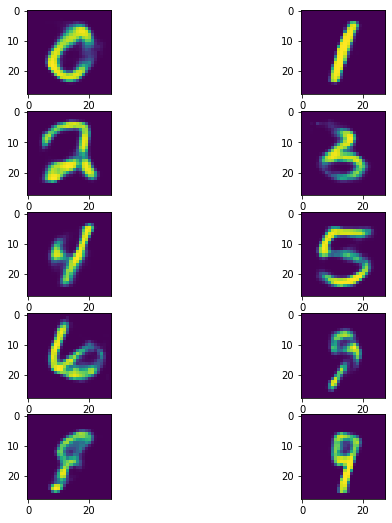

0it [00:00, ?it/s]

====> Epoch: 42 Average loss: 97.8686


0it [00:00, ?it/s]

====> Test set loss: 981810.4106


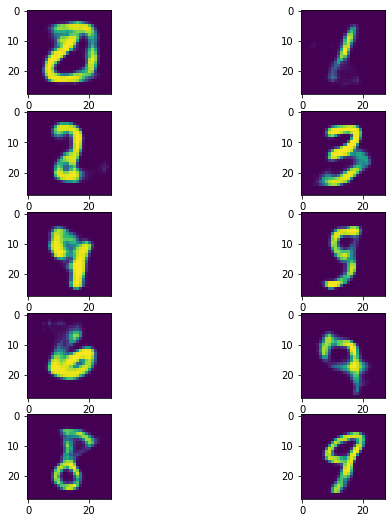

0it [00:00, ?it/s]

====> Epoch: 43 Average loss: 97.7532


0it [00:00, ?it/s]

====> Test set loss: 977608.2400


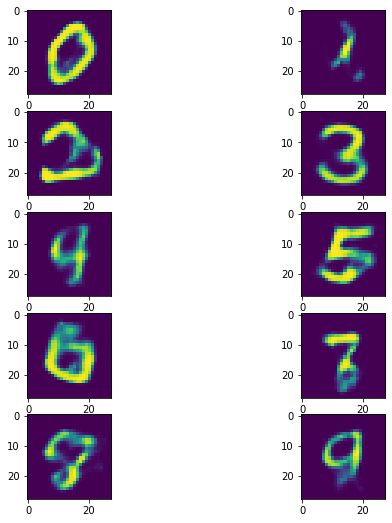

0it [00:00, ?it/s]

====> Epoch: 44 Average loss: 97.7432


0it [00:00, ?it/s]

====> Test set loss: 974568.8870


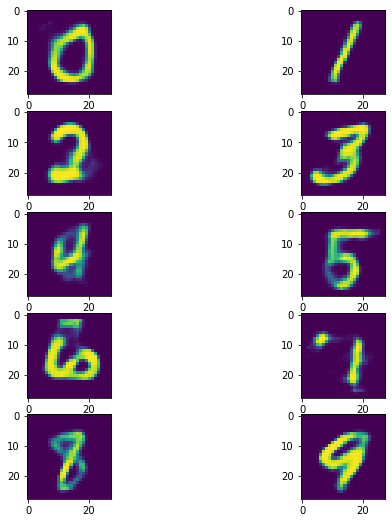

0it [00:00, ?it/s]

====> Epoch: 45 Average loss: 97.7534


0it [00:00, ?it/s]

====> Test set loss: 979535.5741


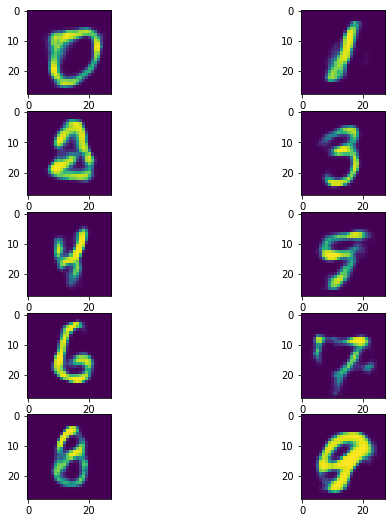

0it [00:00, ?it/s]

====> Epoch: 46 Average loss: 97.6403


0it [00:00, ?it/s]

====> Test set loss: 983453.4860


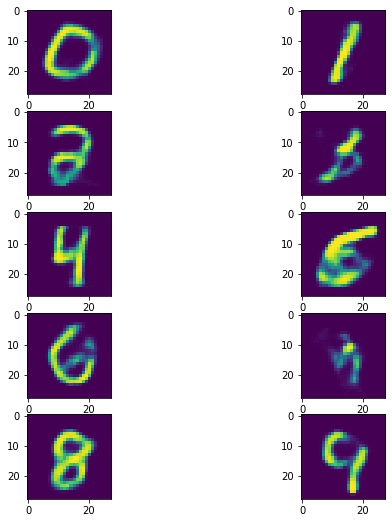

0it [00:00, ?it/s]

====> Epoch: 47 Average loss: 97.5756


0it [00:00, ?it/s]

====> Test set loss: 979141.2998


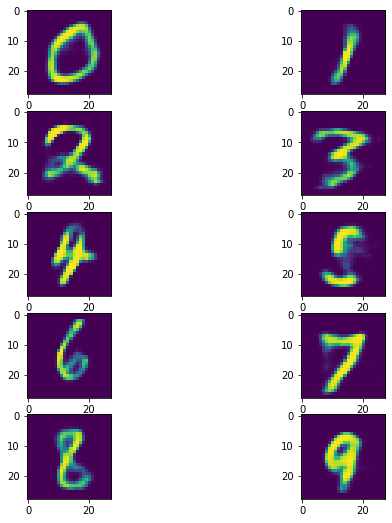

0it [00:00, ?it/s]

====> Epoch: 48 Average loss: 97.5394


0it [00:00, ?it/s]

====> Test set loss: 978862.3851


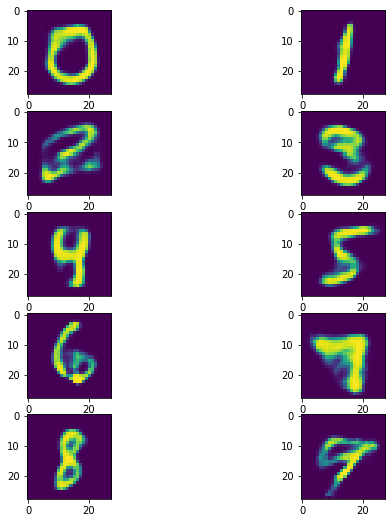

0it [00:00, ?it/s]

====> Epoch: 49 Average loss: 97.4875


0it [00:00, ?it/s]

====> Test set loss: 979317.6719


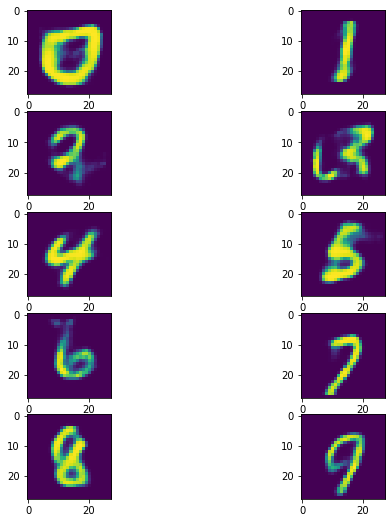

0it [00:00, ?it/s]

====> Epoch: 50 Average loss: 97.4324


0it [00:00, ?it/s]

====> Test set loss: 977098.9523


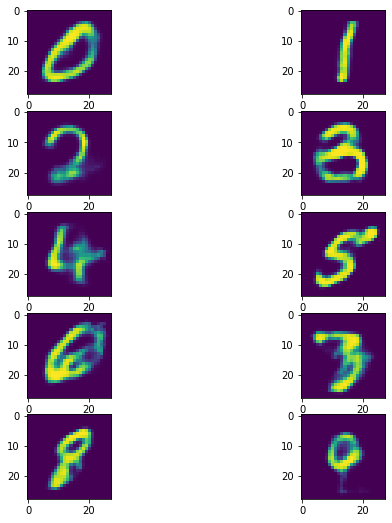

In [108]:
train_loss = []
test_loss = []
for epoch in tqdm(range(1, epochs + 1)):
        train_out = train(epoch)
        test_out = test(epoch)
        with torch.no_grad():
#             plt.figure(figsize=(50,10))
            c = torch.eye(10,10).cuda()
            sample = torch.randn(10, 20).to(device)
            sample = model.decode(sample, c).cpu()  
            plt.figure(figsize=(9, 9))
            for i in range(len(sample)):
                plt.subplot(5, 2, i+1)
                plt.imshow(sample[i].view(28,28))
            plt.show()
            train_loss.append(train_out)
            test_loss.append(test_out)
            

### Sampling


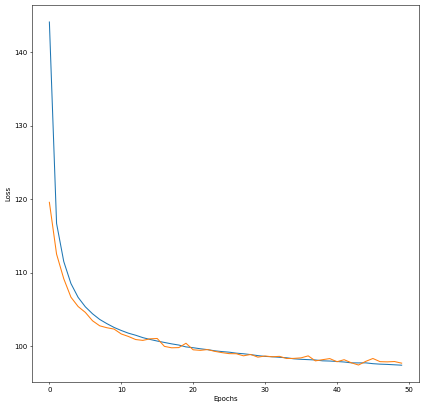

In [109]:
plot_loss(train_loss,test_loss)

Тут мы будем сэмплировать из CVAE. Это прикольнее, чем сэмплировать из простого AE/VAE: тут можно взять один и тот же латентный вектор и попросить CVAE восстановить из него картинки разных классов!
Для MNIST вы можете попросить CVAE восстановить из одного латентного вектора, например, картинки цифры 5 и 7.

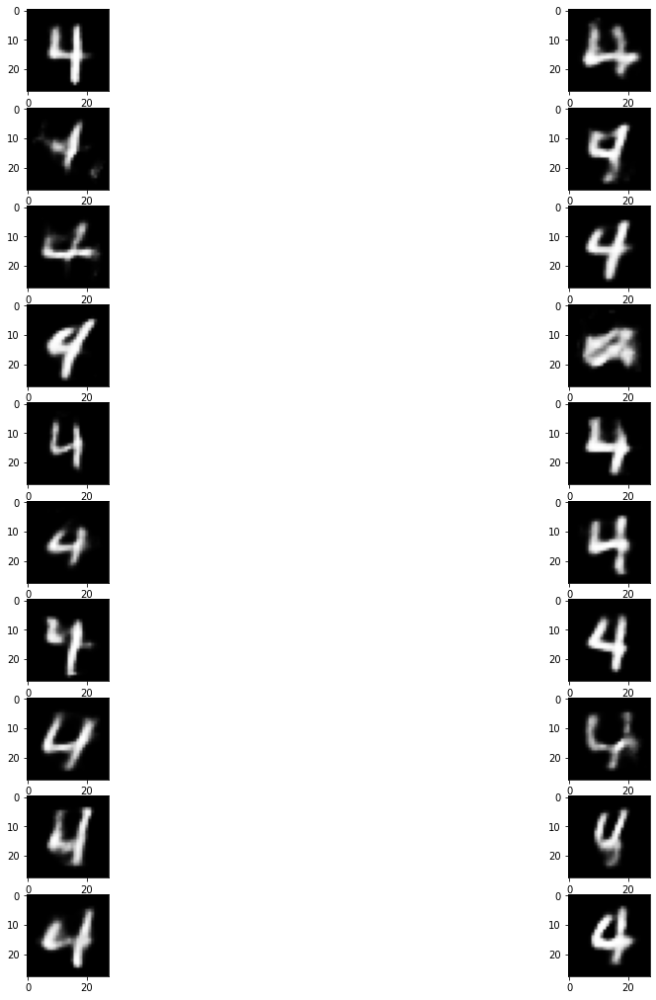

In [110]:
# Try to make 4
NUM_GENERATION = 20
os.makedirs(f'./label5/', exist_ok=True)
model.eval()
plt.figure(figsize=(18, 18))
for i in range(NUM_GENERATION):
    z = torch.randn(latent_size, device=device).unsqueeze(dim=0)
    label = torch.tensor([4], device=device)
    with torch.no_grad():
        y = model.decode(z, torch.eye(10, device=device, dtype=torch.float32)[label])
    y = y.reshape(28, 28).cpu().detach().numpy()
    
    plt.subplot(NUM_GENERATION // 2, 2, i + 1)
    plt.imshow(y,cmap='gray')
plt.show()

Splendid! Вы великолепны!


### Latent Representations

Давайте посмотрим, как выглядит латентное пространство картинок в CVAE и сравним с картинкой для VAE =)

Опять же, нужно покрасить точки в разные цвета в зависимости от класса.

In [144]:
for i, (images,labels) in enumerate(train_loader):
        labels = torch.eye(10, device=device, dtype=torch.float32)[labels]
        # Encode images
        x = images.view(-1, 28*28*1).to(device)
        mu, var = model.encode(x, labels)
        sigma = var.exp().sqrt()
        epsilon = torch.randn(latent_size, device=device)

        # decode
        z = mu + sigma * epsilon
        y = model.decode(z, labels)
       

In [131]:
torch.eye(10, device=device, dtype=torch.float32)[label].shape

torch.Size([16, 10])

In [193]:
encoded_samples = []
for sample in tqdm(test_dataset):
    img = sample[0].unsqueeze(0).to(device)
    label = sample[1]
#     print(label,img.shape)
    # Encode image
    model.eval()
    with torch.no_grad():
        x = img.view(-1, 28*28*1).to(device)
#         print(x.shape,  torch.eye(10, device=device, dtype=torch.float32)[label].view(1,-1).shape)
        mu, var = model.encode(x, torch.eye(10, device=device, dtype=torch.float32)[label].view(1,-1))
        sigma = var.exp().sqrt()
        epsilon = torch.randn(latent_size, device=device)
        z = mu + sigma * epsilon
    # Append to list
    encoded_img = z.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}
    encoded_sample['label'] = label
    encoded_samples.append(encoded_sample)
    
encoded_samples = pd.DataFrame(encoded_samples)
encoded_samples

  0%|          | 0/10000 [00:00<?, ?it/s]

,Enc. Variable 0,Enc. Variable 1,Enc. Variable 2,Enc. Variable 3,Enc. Variable 4,Enc. Variable 5,Enc. Variable 6,Enc. Variable 7,Enc. Variable 8,Enc. Variable 9,...,Enc. Variable 11,Enc. Variable 12,Enc. Variable 13,Enc. Variable 14,Enc. Variable 15,Enc. Variable 16,Enc. Variable 17,Enc. Variable 18,Enc. Variable 19,label
0,0.156447,0.557863,-1.490025,0.628537,0.612902,1.170968,-0.805684,0.376055,-1.943536,-0.149498,...,0.040121,0.265587,0.882210,0.304897,-0.114523,1.856793,-0.268844,-0.928533,0.153676,7
1,-0.651368,1.350148,0.435683,-1.007659,-0.604957,-1.696863,1.733401,0.896254,0.049945,-0.008583,...,0.884246,-0.406882,-1.158368,-0.458213,2.237773,1.029440,2.105758,0.384930,1.277219,2
2,-0.852407,1.633534,0.127615,0.715683,0.457421,2.047622,-0.099115,1.058110,0.777467,-0.593346,...,0.579393,0.278415,1.532747,0.240686,-0.258538,1.429093,0.118538,0.069673,0.481538,1
3,-0.602047,0.351413,0.224789,-0.329099,0.183291,0.102760,0.231306,-1.212700,-0.838748,-0.998603,...,0.558478,1.006990,0.576494,1.282159,-0.672181,-0.207071,-1.491996,-0.205193,0.266351,0
4,-1.541428,1.312146,-1.182603,-1.493911,1.291412,1.280550,0.817410,1.214259,-0.063599,-0.133860,...,-0.496972,0.351484,0.198027,0.352228,-1.395272,-0.557442,-0.740077,-0.011164,1.729052,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,-0.754861,1.153405,0.508319,-0.741593,-0.408935,-0.622133,0.699744,-0.611313,0.620935,0.032477,...,-0.182302,0.248431,-1.344512,0.956968,0.162659,0.049815,-0.470039,0.310188,-0.199953,2
9996,-0.676896,-1.180735,-0.861281,-0.762080,-0.041538,1.695681,0.996389,-0.764546,-0.503219,-0.867359,...,-0.137101,0.790483,-1.277242,1.598191,0.789833,0.919190,-1.152794,-0.475425,0.782613,3
9997,0.404948,-1.330028,0.122851,0.923916,-1.288883,-0.097176,-0.407786,-0.971819,0.357612,0.605247,...,0.165569,0.521273,1.129390,0.729886,0.158936,0.080742,-0.258876,1.838262,1.098391,4
9998,0.045104,1.717551,-0.657748,0.568945,0.204087,0.659110,0.057209,-1.561960,-2.281488,0.014520,...,0.473394,-1.396932,-0.380660,1.231963,1.539770,0.383458,1.818102,-0.867830,2.302305,5


In [194]:
px.scatter(encoded_samples,
           x='Enc. Variable 0', 
           y='Enc. Variable 1',
           color=encoded_samples.label.astype(str), 
           opacity=0.7)

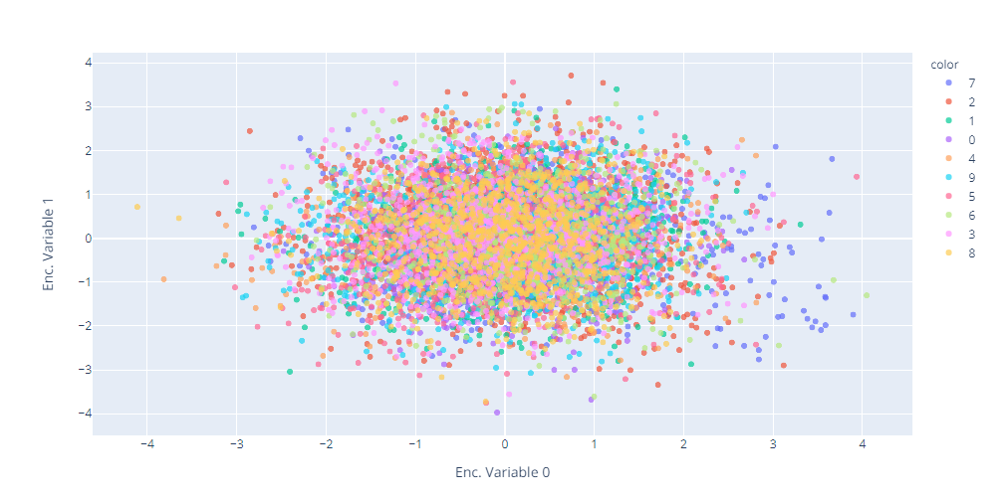

In [198]:
tsne = TSNE(n_components=2)
tsne_results = tsne.fit_transform(encoded_samples.drop(['label'],axis=1))

In [199]:
fig = px.scatter(tsne_results,
                 x=0,
                 y=1,
                 color=encoded_samples.label.astype(str),
                 labels={'0': 'tsne-2d-one', '1': 'tsne-2d-two'})
fig.show()

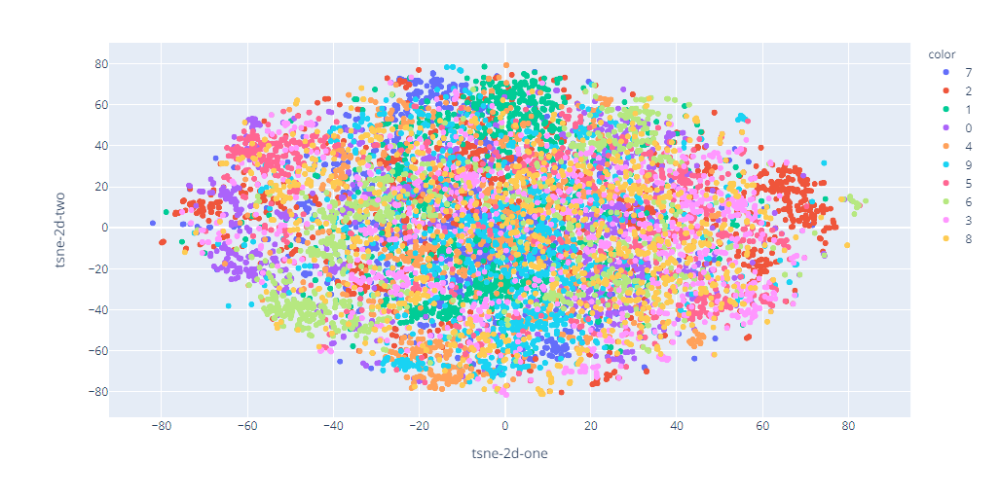

Что вы думаете насчет этой картинки? Отличается от картинки для VAE?

Результат VAE и CVAE отличаются. VAE более сгрупированно.

# BONUS 1: Denoising

## Внимание! За бонусы доп. баллы не ставятся, но вы можете сделать их для себя.

У автоэнкодеров, кроме сжатия и генерации изображений, есть другие практические применения. Про одно из них эта бонусная часть задания.

Автоэнкодеры могут быть использованы для избавления от шума на фотографиях (denoising). Для этого их нужно обучить специальным образом: input картинка будет зашумленной, а выдавать автоэнкодер должен будет картинку без шума. 
То есть, loss-функция AE останется той же (MSE между реальной картинкой и выданной), а на вход автоэнкодеру будет подаваться зашумленная картинка.

<a href="https://ibb.co/YbRJ1nZ"><img src="https://i.ibb.co/0QD164t/Screen-Shot-2020-06-04-at-4-49-50-PM.png" alt="Screen-Shot-2020-06-04-at-4-49-50-PM" border="0"></a>

Для этого нужно взять ваш любимый датасет (датасет лиц из первой части этого задания или любой другой) и сделать копию этого датасета с шумом. 

В питоне шум можно добавить так:

In [ ]:
noise_factor = 0.5
X_noisy = X + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=X.shape) 

In [ ]:
<тут ваш код обучения автоэнкодера на зашумленных картинках. Не забудтье разбить на train/test!>

In [ ]:
<тут проверка, как AE убирает щум с тестовых картинок. Надеюсь, все получилось =)>

# BONUS 2: Image Retrieval

## Внимание! За бонусы доп. баллы не ставятся, но вы можете сделать их для себя.

Давайте представим, что весь наш тренировочный датасет -- это большая база данных людей. И вот мы получили картинку лица какого-то человека с уличной камеры наблюдения (у нас это картинка из тестового датасета) и хотим понять, что это за человек. Что нам делать? Правильно -- берем наш VAE, кодируем картинку в латентное представление и ищем среди латентныз представлений лиц нашей базы самые ближайшие!

План:

1. Получаем латентные представления всех лиц тренировочного датасета
2. Обучаем на них LSHForest `(sklearn.neighbors.LSHForest)`, например, с `n_estimators=50`
3. Берем картинку из тестового датасета, с помощью VAE получаем ее латентный вектор
4. Ищем с помощью обученного LSHForest ближайшие из латентных представлений тренировочной базы
5. Находим лица тренировочного датасета, которым соответствуют ближайшие латентные представления, визуализируем!

Немного кода вам в помощь: (feel free to delete everything and write your own)

In [ ]:
codes = <поучите латентные представления картинок из трейна>

In [ ]:
# обучаем LSHForest
from sklearn.neighbors import LSHForest
lshf = LSHForest(n_estimators=50).fit(codes)

In [ ]:
def get_similar(image, n_neighbors=5):
  # функция, которая берет тестовый image и с помощью метода kneighbours у LSHForest ищет ближайшие векторы
  # прогоняет векторы через декодер и получает картинки ближайших людей

  code = <получение латентного представления image>
    
  (distances,),(idx,) = lshf.kneighbors(code, n_neighbors=n_neighbors)

  return distances, X_train[idx]

In [ ]:
def show_similar(image):

  # функция, которая принимает тестовый image, ищет ближайшие к нему и визуализирует результат
    
    distances,neighbors = get_similar(image,n_neighbors=11)
    
    plt.figure(figsize=[8,6])
    plt.subplot(3,4,1)
    plt.imshow(image.cpu().numpy().transpose([1,2,0]))
    plt.title("Original image")
    
    for i in range(11):
        plt.subplot(3,4,i+2)
        plt.imshow(neighbors[i].cpu().numpy().transpose([1,2,0]))
        plt.title("Dist=%.3f"%distances[i])
    plt.show()